# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [22]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [23]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [24]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [25]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

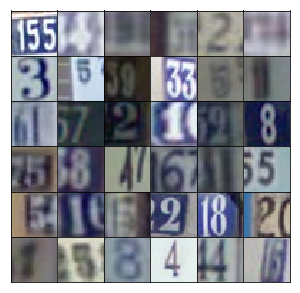

In [26]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [27]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [28]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [29]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [30]:
def LeakyReLU(h, alpha):
    return tf.maximum(alpha * h, h)

def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected Hidden layer: 4x4x512
        x1 = tf.layers.dense(z, 4*4*512, use_bias=False, activation=None)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)         
        x1 = LeakyReLU(x1, alpha)

        # First conv Hidden layer: 8x8x256
        h1 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        h1 = tf.layers.batch_normalization(h1, training=training)         
        h1 = LeakyReLU(h1, alpha)

        # Second conv Hidden layer: 16x16x128
        h2 = tf.layers.conv2d_transpose(h1, 128, 5, strides=2, padding='same')
        h2 = tf.layers.batch_normalization(h2, training=training)         
        h2 = LeakyReLU(h2, alpha)
       
        # Output layer, 32x32x3
        logits =tf.layers.conv2d_transpose(h2, output_dim, 5, strides=2, padding='same')       
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [31]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Layer 1: Input layer is 32x32x3
        h1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        h1 = LeakyReLU(h1, alpha)

        # Layer 2: Input is 16x16x64
        h2 = tf.layers.conv2d(h1, 128, 5, strides=2, padding='same')
        h2 = tf.layers.batch_normalization(h2, training=True)                 
        h2 = LeakyReLU(h2, alpha)

        # Layer 3: Input is 8x8x128
        h3 = tf.layers.conv2d(h2, 256, 5, strides=2, padding='same')
        h3 = tf.layers.batch_normalization(h3, training=True)                 
        h3 = LeakyReLU(h3, alpha)
                        
        # Final Layer: Input is 4x4x256
        h3_flat = tf.reshape(h3, (-1, 4*4*256))
        logits = tf.layers.dense(h3_flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [32]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Again, nothing new here.

In [33]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [34]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [35]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img)
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network.

In [36]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(50, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 5, 10, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [37]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002 # 0.001
batch_size = 128 # 64
epochs = 25 # 1
alpha = 0.2 # 0.01
beta1 = 0.5 # 0.9

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2200... Generator Loss: 0.6790
Epoch 1/25... Discriminator Loss: 0.3945... Generator Loss: 1.7611
Epoch 1/25... Discriminator Loss: 0.1397... Generator Loss: 2.8063
Epoch 1/25... Discriminator Loss: 0.1438... Generator Loss: 2.7630
Epoch 1/25... Discriminator Loss: 0.2038... Generator Loss: 2.3776
Epoch 1/25... Discriminator Loss: 0.0979... Generator Loss: 3.2337
Epoch 1/25... Discriminator Loss: 0.1166... Generator Loss: 3.0020
Epoch 1/25... Discriminator Loss: 0.3881... Generator Loss: 2.0387
Epoch 1/25... Discriminator Loss: 0.1239... Generator Loss: 2.9717
Epoch 1/25... Discriminator Loss: 0.2456... Generator Loss: 2.5148


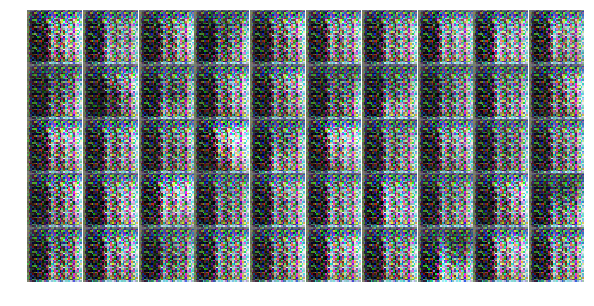

Epoch 1/25... Discriminator Loss: 0.2968... Generator Loss: 3.5699
Epoch 1/25... Discriminator Loss: 0.5341... Generator Loss: 1.6295
Epoch 1/25... Discriminator Loss: 0.7172... Generator Loss: 1.6633
Epoch 1/25... Discriminator Loss: 0.4651... Generator Loss: 1.6901
Epoch 1/25... Discriminator Loss: 0.6636... Generator Loss: 1.1845
Epoch 1/25... Discriminator Loss: 0.5335... Generator Loss: 1.3842
Epoch 1/25... Discriminator Loss: 0.4582... Generator Loss: 1.8797
Epoch 1/25... Discriminator Loss: 0.3258... Generator Loss: 3.5144
Epoch 1/25... Discriminator Loss: 1.0418... Generator Loss: 0.6900
Epoch 1/25... Discriminator Loss: 0.3226... Generator Loss: 2.1421


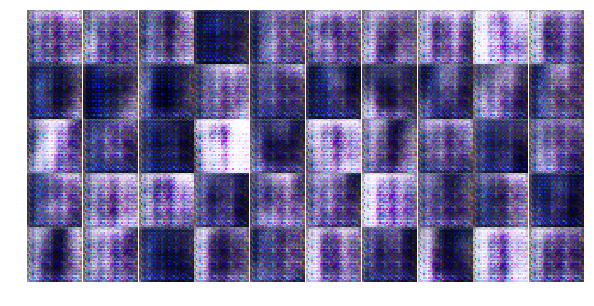

Epoch 1/25... Discriminator Loss: 0.2869... Generator Loss: 3.3622
Epoch 1/25... Discriminator Loss: 2.1055... Generator Loss: 8.8044
Epoch 1/25... Discriminator Loss: 0.3283... Generator Loss: 2.4609
Epoch 1/25... Discriminator Loss: 0.1897... Generator Loss: 2.8454
Epoch 1/25... Discriminator Loss: 1.0081... Generator Loss: 5.7123
Epoch 1/25... Discriminator Loss: 2.7101... Generator Loss: 7.4433
Epoch 1/25... Discriminator Loss: 0.2073... Generator Loss: 3.1395
Epoch 1/25... Discriminator Loss: 0.1883... Generator Loss: 2.2379
Epoch 1/25... Discriminator Loss: 0.6807... Generator Loss: 3.1325
Epoch 1/25... Discriminator Loss: 0.3496... Generator Loss: 3.4867


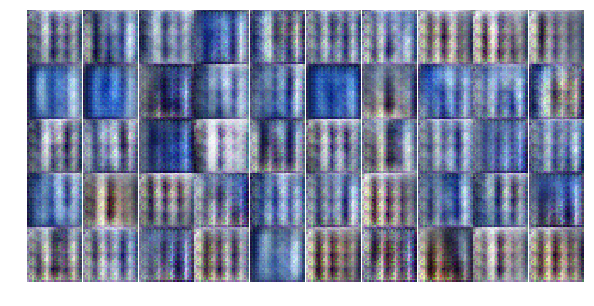

Epoch 1/25... Discriminator Loss: 1.2655... Generator Loss: 1.3029
Epoch 1/25... Discriminator Loss: 0.9286... Generator Loss: 1.0032
Epoch 1/25... Discriminator Loss: 0.4082... Generator Loss: 2.6505
Epoch 1/25... Discriminator Loss: 1.0860... Generator Loss: 0.6456
Epoch 1/25... Discriminator Loss: 0.6202... Generator Loss: 1.3024
Epoch 1/25... Discriminator Loss: 0.7254... Generator Loss: 1.2253
Epoch 1/25... Discriminator Loss: 1.1394... Generator Loss: 0.6322
Epoch 1/25... Discriminator Loss: 0.7529... Generator Loss: 1.7497
Epoch 1/25... Discriminator Loss: 0.7214... Generator Loss: 2.0065
Epoch 1/25... Discriminator Loss: 0.4632... Generator Loss: 2.0664


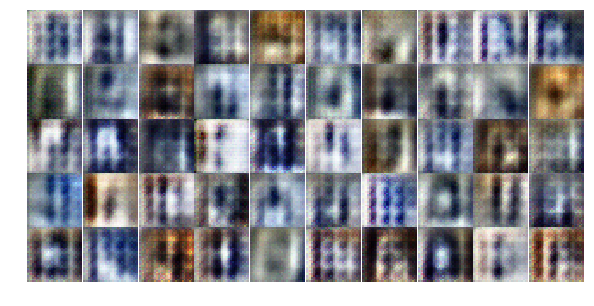

Epoch 1/25... Discriminator Loss: 0.6877... Generator Loss: 1.1116
Epoch 1/25... Discriminator Loss: 0.8994... Generator Loss: 1.0459
Epoch 1/25... Discriminator Loss: 0.5766... Generator Loss: 1.7977
Epoch 1/25... Discriminator Loss: 0.6892... Generator Loss: 1.9034
Epoch 1/25... Discriminator Loss: 0.4611... Generator Loss: 1.6729
Epoch 1/25... Discriminator Loss: 0.7301... Generator Loss: 1.8965
Epoch 1/25... Discriminator Loss: 0.6309... Generator Loss: 1.4989
Epoch 1/25... Discriminator Loss: 0.8213... Generator Loss: 1.2923
Epoch 1/25... Discriminator Loss: 1.1286... Generator Loss: 2.8071
Epoch 1/25... Discriminator Loss: 0.8729... Generator Loss: 1.2365


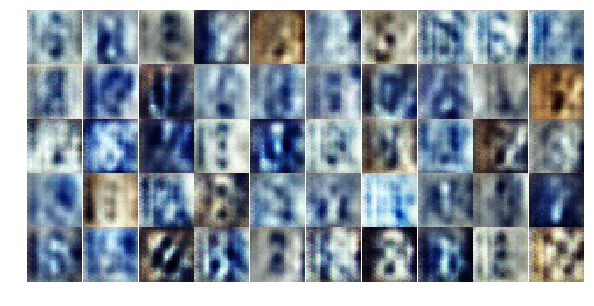

Epoch 1/25... Discriminator Loss: 0.6758... Generator Loss: 1.3093
Epoch 1/25... Discriminator Loss: 0.8385... Generator Loss: 1.1467
Epoch 1/25... Discriminator Loss: 0.5425... Generator Loss: 1.7658
Epoch 1/25... Discriminator Loss: 0.9060... Generator Loss: 1.1239
Epoch 1/25... Discriminator Loss: 0.6824... Generator Loss: 1.4581
Epoch 1/25... Discriminator Loss: 0.5563... Generator Loss: 1.4628
Epoch 1/25... Discriminator Loss: 0.8153... Generator Loss: 1.2135
Epoch 2/25... Discriminator Loss: 1.1831... Generator Loss: 1.0744
Epoch 2/25... Discriminator Loss: 1.0487... Generator Loss: 1.3739
Epoch 2/25... Discriminator Loss: 0.9272... Generator Loss: 0.9216


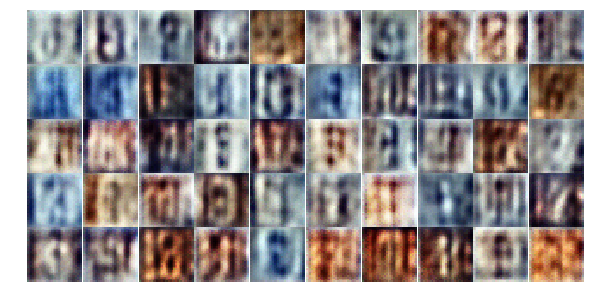

Epoch 2/25... Discriminator Loss: 0.9576... Generator Loss: 1.0708
Epoch 2/25... Discriminator Loss: 0.9673... Generator Loss: 0.8746
Epoch 2/25... Discriminator Loss: 1.2920... Generator Loss: 0.7211
Epoch 2/25... Discriminator Loss: 0.6830... Generator Loss: 1.4572
Epoch 2/25... Discriminator Loss: 0.9109... Generator Loss: 1.0740
Epoch 2/25... Discriminator Loss: 0.8263... Generator Loss: 1.2615
Epoch 2/25... Discriminator Loss: 1.0755... Generator Loss: 0.9732
Epoch 2/25... Discriminator Loss: 1.0011... Generator Loss: 1.0084
Epoch 2/25... Discriminator Loss: 1.1136... Generator Loss: 1.3934
Epoch 2/25... Discriminator Loss: 1.1851... Generator Loss: 0.7824


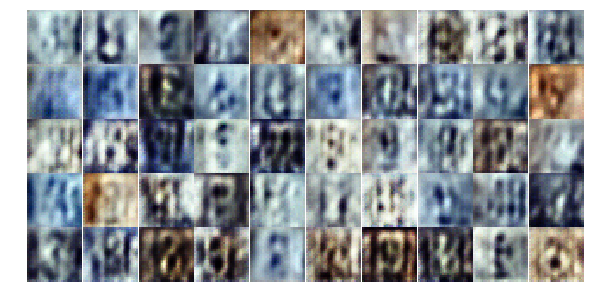

Epoch 2/25... Discriminator Loss: 1.0951... Generator Loss: 0.8613
Epoch 2/25... Discriminator Loss: 0.9711... Generator Loss: 1.2813
Epoch 2/25... Discriminator Loss: 0.8203... Generator Loss: 1.1933
Epoch 2/25... Discriminator Loss: 1.0973... Generator Loss: 0.6124
Epoch 2/25... Discriminator Loss: 0.9737... Generator Loss: 1.5797
Epoch 2/25... Discriminator Loss: 1.4583... Generator Loss: 0.7132
Epoch 2/25... Discriminator Loss: 1.3889... Generator Loss: 1.1621
Epoch 2/25... Discriminator Loss: 1.0908... Generator Loss: 0.7835
Epoch 2/25... Discriminator Loss: 1.1742... Generator Loss: 0.6296
Epoch 2/25... Discriminator Loss: 0.9275... Generator Loss: 0.8419


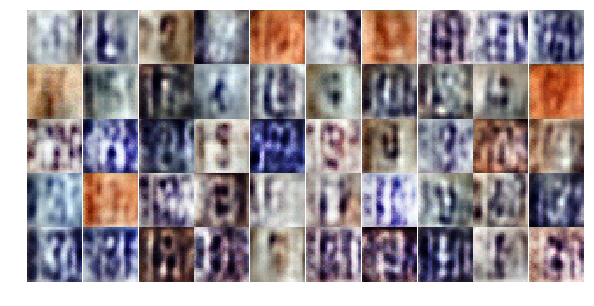

Epoch 2/25... Discriminator Loss: 0.7834... Generator Loss: 1.2159
Epoch 2/25... Discriminator Loss: 1.0297... Generator Loss: 1.0338
Epoch 2/25... Discriminator Loss: 0.8496... Generator Loss: 0.9870
Epoch 2/25... Discriminator Loss: 0.8463... Generator Loss: 1.7541
Epoch 2/25... Discriminator Loss: 0.9328... Generator Loss: 1.0765
Epoch 2/25... Discriminator Loss: 1.0393... Generator Loss: 0.9242
Epoch 2/25... Discriminator Loss: 1.1447... Generator Loss: 0.5814
Epoch 2/25... Discriminator Loss: 0.9427... Generator Loss: 1.1213
Epoch 2/25... Discriminator Loss: 1.2632... Generator Loss: 0.7280
Epoch 2/25... Discriminator Loss: 0.7671... Generator Loss: 1.4095


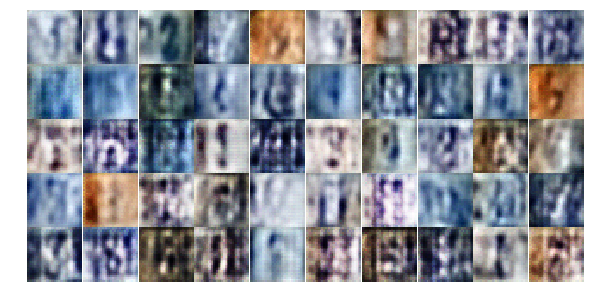

Epoch 2/25... Discriminator Loss: 0.8506... Generator Loss: 1.1583
Epoch 2/25... Discriminator Loss: 0.9965... Generator Loss: 0.8981
Epoch 2/25... Discriminator Loss: 1.0674... Generator Loss: 0.7119
Epoch 2/25... Discriminator Loss: 1.1713... Generator Loss: 0.5701
Epoch 2/25... Discriminator Loss: 0.9666... Generator Loss: 1.9540
Epoch 2/25... Discriminator Loss: 1.1146... Generator Loss: 1.3544
Epoch 2/25... Discriminator Loss: 1.0500... Generator Loss: 0.7520
Epoch 2/25... Discriminator Loss: 0.8800... Generator Loss: 1.4709
Epoch 2/25... Discriminator Loss: 0.8295... Generator Loss: 1.2815
Epoch 2/25... Discriminator Loss: 0.6528... Generator Loss: 1.8699


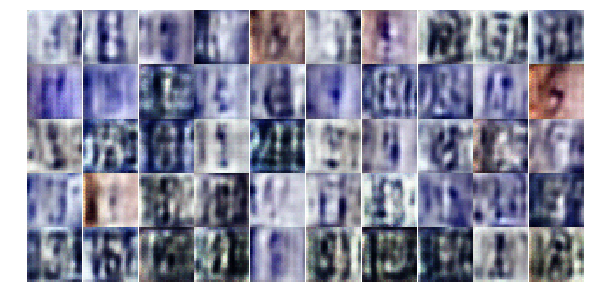

Epoch 2/25... Discriminator Loss: 0.6312... Generator Loss: 1.9383
Epoch 2/25... Discriminator Loss: 0.9346... Generator Loss: 0.9412
Epoch 2/25... Discriminator Loss: 0.6233... Generator Loss: 1.2385
Epoch 2/25... Discriminator Loss: 1.2045... Generator Loss: 0.5280
Epoch 2/25... Discriminator Loss: 1.2022... Generator Loss: 1.1099
Epoch 2/25... Discriminator Loss: 0.9598... Generator Loss: 0.7722
Epoch 2/25... Discriminator Loss: 0.9362... Generator Loss: 1.5399
Epoch 2/25... Discriminator Loss: 0.9886... Generator Loss: 0.9366
Epoch 2/25... Discriminator Loss: 0.8125... Generator Loss: 1.2173
Epoch 2/25... Discriminator Loss: 0.6627... Generator Loss: 1.5924


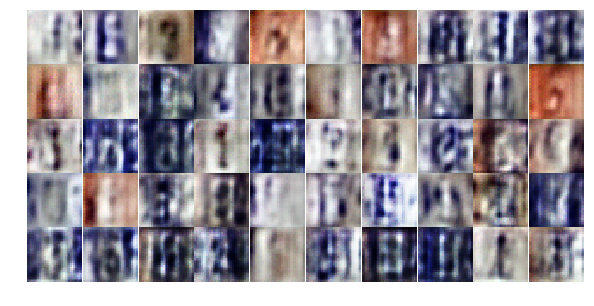

Epoch 2/25... Discriminator Loss: 0.7827... Generator Loss: 1.2066
Epoch 2/25... Discriminator Loss: 0.6955... Generator Loss: 1.2069
Epoch 2/25... Discriminator Loss: 0.5652... Generator Loss: 1.5882
Epoch 2/25... Discriminator Loss: 0.6490... Generator Loss: 1.1060
Epoch 3/25... Discriminator Loss: 0.7756... Generator Loss: 1.8533
Epoch 3/25... Discriminator Loss: 0.7528... Generator Loss: 1.3923
Epoch 3/25... Discriminator Loss: 0.5581... Generator Loss: 1.3986
Epoch 3/25... Discriminator Loss: 0.9334... Generator Loss: 0.8032
Epoch 3/25... Discriminator Loss: 0.6254... Generator Loss: 1.6092
Epoch 3/25... Discriminator Loss: 0.7338... Generator Loss: 1.2759


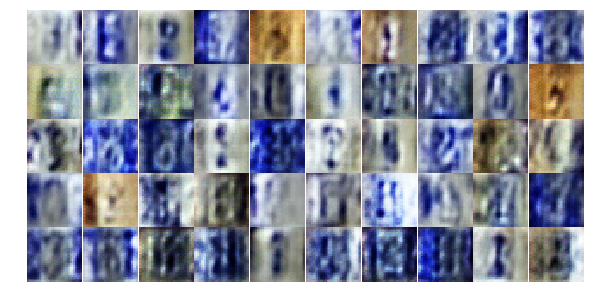

Epoch 3/25... Discriminator Loss: 0.7279... Generator Loss: 1.5474
Epoch 3/25... Discriminator Loss: 0.7233... Generator Loss: 1.5874
Epoch 3/25... Discriminator Loss: 0.8314... Generator Loss: 0.9893
Epoch 3/25... Discriminator Loss: 0.8897... Generator Loss: 0.9295
Epoch 3/25... Discriminator Loss: 0.5313... Generator Loss: 1.6862
Epoch 3/25... Discriminator Loss: 0.7879... Generator Loss: 1.1586
Epoch 3/25... Discriminator Loss: 0.3056... Generator Loss: 2.0771
Epoch 3/25... Discriminator Loss: 0.8500... Generator Loss: 1.0080
Epoch 3/25... Discriminator Loss: 1.5863... Generator Loss: 4.3285
Epoch 3/25... Discriminator Loss: 0.9783... Generator Loss: 0.7795


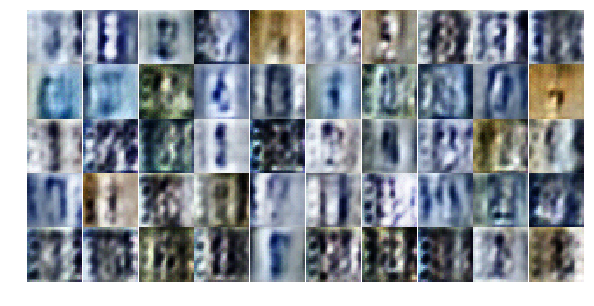

Epoch 3/25... Discriminator Loss: 0.8487... Generator Loss: 1.2243
Epoch 3/25... Discriminator Loss: 0.6339... Generator Loss: 1.3351
Epoch 3/25... Discriminator Loss: 0.8046... Generator Loss: 1.8598
Epoch 3/25... Discriminator Loss: 0.5053... Generator Loss: 1.5283
Epoch 3/25... Discriminator Loss: 0.6816... Generator Loss: 1.3452
Epoch 3/25... Discriminator Loss: 0.7234... Generator Loss: 1.4657
Epoch 3/25... Discriminator Loss: 0.6249... Generator Loss: 1.4496
Epoch 3/25... Discriminator Loss: 0.6639... Generator Loss: 1.3289
Epoch 3/25... Discriminator Loss: 0.3407... Generator Loss: 2.3386
Epoch 3/25... Discriminator Loss: 1.0113... Generator Loss: 0.7221


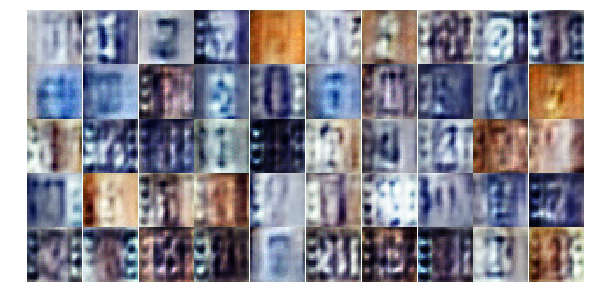

Epoch 3/25... Discriminator Loss: 0.4913... Generator Loss: 1.6960
Epoch 3/25... Discriminator Loss: 0.9061... Generator Loss: 2.1382
Epoch 3/25... Discriminator Loss: 0.9123... Generator Loss: 1.2953
Epoch 3/25... Discriminator Loss: 0.8613... Generator Loss: 2.4398
Epoch 3/25... Discriminator Loss: 0.6721... Generator Loss: 1.1876
Epoch 3/25... Discriminator Loss: 0.9535... Generator Loss: 0.8678
Epoch 3/25... Discriminator Loss: 0.7883... Generator Loss: 1.3225
Epoch 3/25... Discriminator Loss: 0.4834... Generator Loss: 1.7315
Epoch 3/25... Discriminator Loss: 0.4939... Generator Loss: 1.6357
Epoch 3/25... Discriminator Loss: 1.0393... Generator Loss: 0.5974


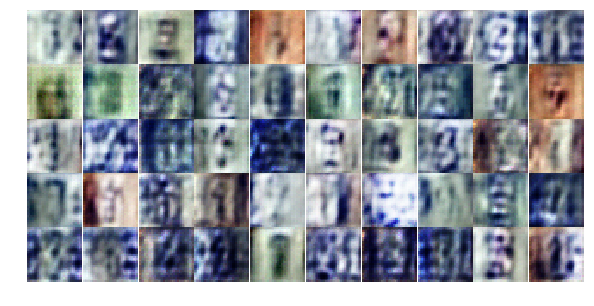

Epoch 3/25... Discriminator Loss: 1.3473... Generator Loss: 1.0566
Epoch 3/25... Discriminator Loss: 0.4671... Generator Loss: 1.6685
Epoch 3/25... Discriminator Loss: 0.7499... Generator Loss: 1.0957
Epoch 3/25... Discriminator Loss: 0.8629... Generator Loss: 0.8261
Epoch 3/25... Discriminator Loss: 0.2760... Generator Loss: 2.3337
Epoch 3/25... Discriminator Loss: 1.2803... Generator Loss: 2.7232
Epoch 3/25... Discriminator Loss: 0.6196... Generator Loss: 1.5537
Epoch 3/25... Discriminator Loss: 0.8386... Generator Loss: 1.0239
Epoch 3/25... Discriminator Loss: 0.9433... Generator Loss: 1.8910
Epoch 3/25... Discriminator Loss: 1.0581... Generator Loss: 0.8248


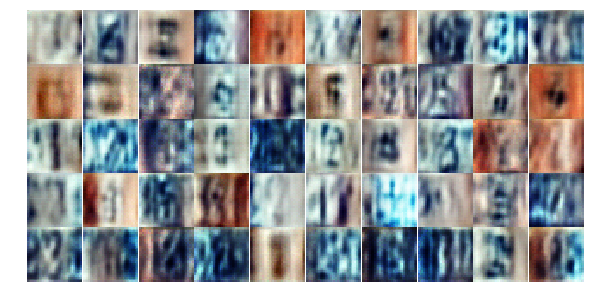

Epoch 3/25... Discriminator Loss: 0.9113... Generator Loss: 1.2950
Epoch 3/25... Discriminator Loss: 0.8634... Generator Loss: 1.6266
Epoch 3/25... Discriminator Loss: 0.6908... Generator Loss: 1.1026
Epoch 3/25... Discriminator Loss: 1.0756... Generator Loss: 0.6697
Epoch 3/25... Discriminator Loss: 0.6796... Generator Loss: 1.3349
Epoch 3/25... Discriminator Loss: 0.3284... Generator Loss: 2.5211
Epoch 3/25... Discriminator Loss: 0.6014... Generator Loss: 1.3137
Epoch 3/25... Discriminator Loss: 0.3930... Generator Loss: 1.6387
Epoch 3/25... Discriminator Loss: 0.7521... Generator Loss: 1.3313
Epoch 3/25... Discriminator Loss: 0.4155... Generator Loss: 3.3306


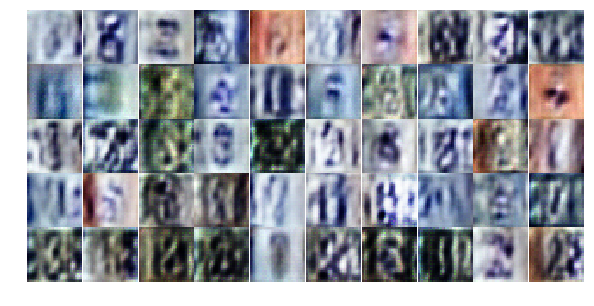

Epoch 3/25... Discriminator Loss: 1.9618... Generator Loss: 0.2424
Epoch 4/25... Discriminator Loss: 0.8587... Generator Loss: 0.9831
Epoch 4/25... Discriminator Loss: 0.9124... Generator Loss: 1.2054
Epoch 4/25... Discriminator Loss: 0.6402... Generator Loss: 1.1789
Epoch 4/25... Discriminator Loss: 0.4765... Generator Loss: 1.5778
Epoch 4/25... Discriminator Loss: 0.3974... Generator Loss: 1.9846
Epoch 4/25... Discriminator Loss: 0.9510... Generator Loss: 2.9183
Epoch 4/25... Discriminator Loss: 0.5738... Generator Loss: 1.5866
Epoch 4/25... Discriminator Loss: 0.4866... Generator Loss: 1.3100
Epoch 4/25... Discriminator Loss: 0.4464... Generator Loss: 1.9150


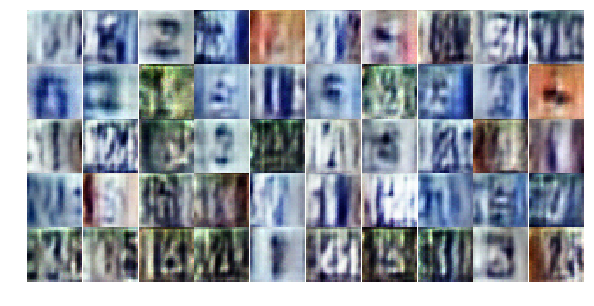

Epoch 4/25... Discriminator Loss: 0.5814... Generator Loss: 1.6006
Epoch 4/25... Discriminator Loss: 0.6913... Generator Loss: 0.9509
Epoch 4/25... Discriminator Loss: 0.9952... Generator Loss: 0.6365
Epoch 4/25... Discriminator Loss: 0.4934... Generator Loss: 1.4648
Epoch 4/25... Discriminator Loss: 0.7321... Generator Loss: 2.0688
Epoch 4/25... Discriminator Loss: 1.2575... Generator Loss: 0.5421
Epoch 4/25... Discriminator Loss: 1.4263... Generator Loss: 0.3573
Epoch 4/25... Discriminator Loss: 0.6483... Generator Loss: 1.5997
Epoch 4/25... Discriminator Loss: 0.7520... Generator Loss: 1.0296
Epoch 4/25... Discriminator Loss: 0.7388... Generator Loss: 2.0719


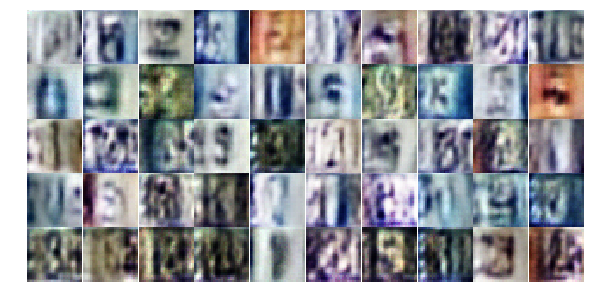

Epoch 4/25... Discriminator Loss: 0.7347... Generator Loss: 1.0129
Epoch 4/25... Discriminator Loss: 0.4805... Generator Loss: 2.3917
Epoch 4/25... Discriminator Loss: 0.3810... Generator Loss: 1.8486
Epoch 4/25... Discriminator Loss: 0.4320... Generator Loss: 1.6285
Epoch 4/25... Discriminator Loss: 0.3898... Generator Loss: 1.6902
Epoch 4/25... Discriminator Loss: 0.6718... Generator Loss: 2.5988
Epoch 4/25... Discriminator Loss: 0.3716... Generator Loss: 2.0200
Epoch 4/25... Discriminator Loss: 0.6507... Generator Loss: 1.0839
Epoch 4/25... Discriminator Loss: 0.4250... Generator Loss: 2.3766
Epoch 4/25... Discriminator Loss: 0.5420... Generator Loss: 1.4322


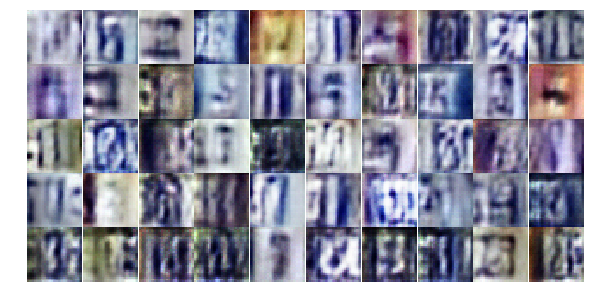

Epoch 4/25... Discriminator Loss: 0.5023... Generator Loss: 1.4691
Epoch 4/25... Discriminator Loss: 0.8461... Generator Loss: 2.2951
Epoch 4/25... Discriminator Loss: 0.5837... Generator Loss: 1.4030
Epoch 4/25... Discriminator Loss: 0.4566... Generator Loss: 1.4474
Epoch 4/25... Discriminator Loss: 0.5098... Generator Loss: 1.5488
Epoch 4/25... Discriminator Loss: 0.4805... Generator Loss: 3.3006
Epoch 4/25... Discriminator Loss: 0.7245... Generator Loss: 1.3404
Epoch 4/25... Discriminator Loss: 0.6529... Generator Loss: 1.3637
Epoch 4/25... Discriminator Loss: 0.6480... Generator Loss: 0.9814
Epoch 4/25... Discriminator Loss: 0.6725... Generator Loss: 0.9645


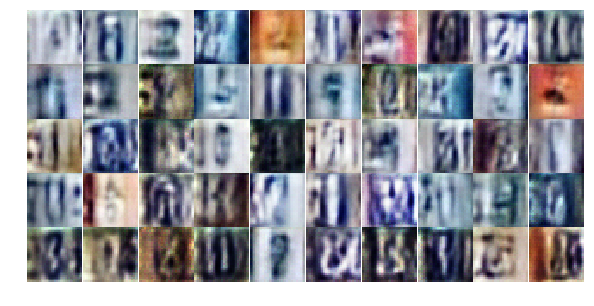

Epoch 4/25... Discriminator Loss: 0.5838... Generator Loss: 1.6538
Epoch 4/25... Discriminator Loss: 0.1997... Generator Loss: 2.1990
Epoch 4/25... Discriminator Loss: 0.7627... Generator Loss: 1.0705
Epoch 4/25... Discriminator Loss: 0.4877... Generator Loss: 1.3594
Epoch 4/25... Discriminator Loss: 0.2995... Generator Loss: 2.3184
Epoch 4/25... Discriminator Loss: 0.5934... Generator Loss: 1.8947
Epoch 4/25... Discriminator Loss: 1.1031... Generator Loss: 4.0112
Epoch 4/25... Discriminator Loss: 0.7525... Generator Loss: 2.3090
Epoch 4/25... Discriminator Loss: 0.3462... Generator Loss: 1.7888
Epoch 4/25... Discriminator Loss: 0.6374... Generator Loss: 1.4314


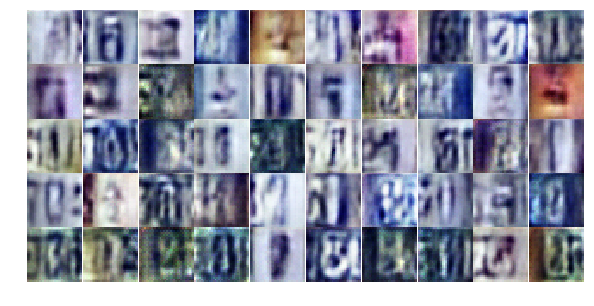

Epoch 4/25... Discriminator Loss: 0.4228... Generator Loss: 1.9801
Epoch 4/25... Discriminator Loss: 0.5119... Generator Loss: 2.2144
Epoch 4/25... Discriminator Loss: 0.3034... Generator Loss: 2.1514
Epoch 4/25... Discriminator Loss: 1.5521... Generator Loss: 3.1373
Epoch 4/25... Discriminator Loss: 0.7933... Generator Loss: 1.6982
Epoch 4/25... Discriminator Loss: 1.0336... Generator Loss: 0.6516
Epoch 4/25... Discriminator Loss: 1.1556... Generator Loss: 0.4967
Epoch 4/25... Discriminator Loss: 0.6687... Generator Loss: 1.1660
Epoch 4/25... Discriminator Loss: 0.4996... Generator Loss: 1.6461
Epoch 5/25... Discriminator Loss: 0.3976... Generator Loss: 1.5101


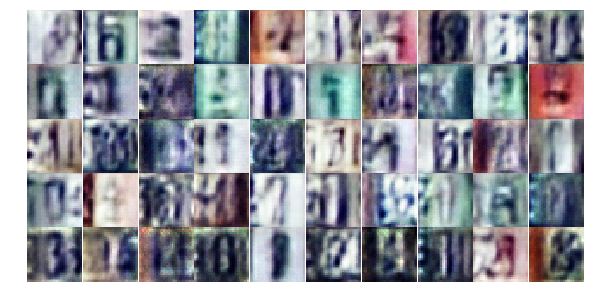

Epoch 5/25... Discriminator Loss: 0.4301... Generator Loss: 1.5249
Epoch 5/25... Discriminator Loss: 0.2892... Generator Loss: 2.3463
Epoch 5/25... Discriminator Loss: 0.6283... Generator Loss: 1.1486
Epoch 5/25... Discriminator Loss: 0.6352... Generator Loss: 0.9986
Epoch 5/25... Discriminator Loss: 0.6273... Generator Loss: 2.6438
Epoch 5/25... Discriminator Loss: 1.0825... Generator Loss: 0.5532
Epoch 5/25... Discriminator Loss: 0.4498... Generator Loss: 1.7216
Epoch 5/25... Discriminator Loss: 0.3352... Generator Loss: 1.7043
Epoch 5/25... Discriminator Loss: 0.8412... Generator Loss: 0.7496
Epoch 5/25... Discriminator Loss: 0.9608... Generator Loss: 0.6872


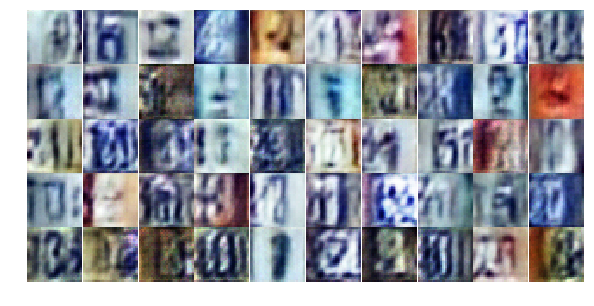

Epoch 5/25... Discriminator Loss: 1.2822... Generator Loss: 2.6440
Epoch 5/25... Discriminator Loss: 0.5463... Generator Loss: 1.6556
Epoch 5/25... Discriminator Loss: 0.5388... Generator Loss: 1.3282
Epoch 5/25... Discriminator Loss: 1.2029... Generator Loss: 0.5200
Epoch 5/25... Discriminator Loss: 0.6186... Generator Loss: 1.4633
Epoch 5/25... Discriminator Loss: 0.8645... Generator Loss: 0.8517
Epoch 5/25... Discriminator Loss: 0.8959... Generator Loss: 0.7995
Epoch 5/25... Discriminator Loss: 0.4750... Generator Loss: 1.5486
Epoch 5/25... Discriminator Loss: 0.5307... Generator Loss: 2.2224
Epoch 5/25... Discriminator Loss: 0.5499... Generator Loss: 1.1868


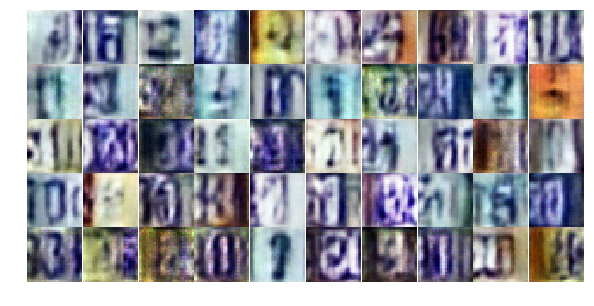

Epoch 5/25... Discriminator Loss: 0.5236... Generator Loss: 1.2623
Epoch 5/25... Discriminator Loss: 0.8476... Generator Loss: 0.8247
Epoch 5/25... Discriminator Loss: 0.6025... Generator Loss: 1.0660
Epoch 5/25... Discriminator Loss: 1.3665... Generator Loss: 0.3858
Epoch 5/25... Discriminator Loss: 1.3854... Generator Loss: 0.4570
Epoch 5/25... Discriminator Loss: 0.8494... Generator Loss: 1.1028
Epoch 5/25... Discriminator Loss: 0.5442... Generator Loss: 1.2070
Epoch 5/25... Discriminator Loss: 0.5551... Generator Loss: 1.6140
Epoch 5/25... Discriminator Loss: 0.8548... Generator Loss: 0.7435
Epoch 5/25... Discriminator Loss: 0.3136... Generator Loss: 1.8640


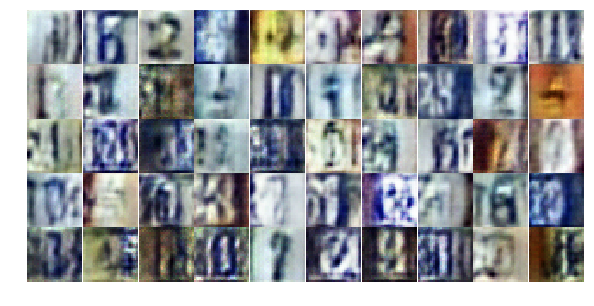

Epoch 5/25... Discriminator Loss: 0.5724... Generator Loss: 1.3920
Epoch 5/25... Discriminator Loss: 0.5231... Generator Loss: 1.8156
Epoch 5/25... Discriminator Loss: 0.5093... Generator Loss: 1.9259
Epoch 5/25... Discriminator Loss: 0.4513... Generator Loss: 2.3727
Epoch 5/25... Discriminator Loss: 1.0506... Generator Loss: 0.8628
Epoch 5/25... Discriminator Loss: 0.5538... Generator Loss: 1.3745
Epoch 5/25... Discriminator Loss: 0.6908... Generator Loss: 1.0789
Epoch 5/25... Discriminator Loss: 0.5559... Generator Loss: 1.4256
Epoch 5/25... Discriminator Loss: 0.9662... Generator Loss: 0.6164
Epoch 5/25... Discriminator Loss: 0.5807... Generator Loss: 1.6614


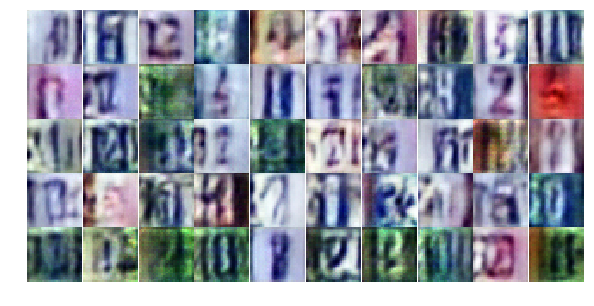

Epoch 5/25... Discriminator Loss: 0.3781... Generator Loss: 2.0288
Epoch 5/25... Discriminator Loss: 0.6516... Generator Loss: 1.0386
Epoch 5/25... Discriminator Loss: 1.4561... Generator Loss: 0.3560
Epoch 5/25... Discriminator Loss: 0.7404... Generator Loss: 1.1628
Epoch 5/25... Discriminator Loss: 0.7661... Generator Loss: 1.2159
Epoch 5/25... Discriminator Loss: 0.9701... Generator Loss: 0.7366
Epoch 5/25... Discriminator Loss: 0.6678... Generator Loss: 1.1914
Epoch 5/25... Discriminator Loss: 0.5776... Generator Loss: 1.5514
Epoch 5/25... Discriminator Loss: 0.5707... Generator Loss: 1.3226
Epoch 5/25... Discriminator Loss: 0.6231... Generator Loss: 1.2282


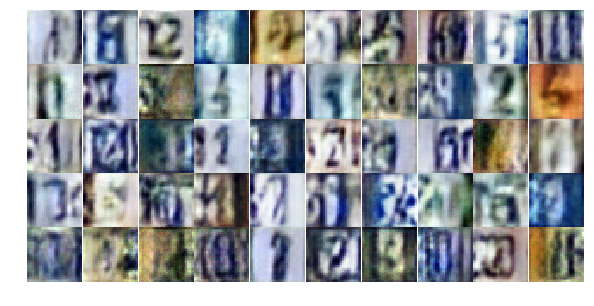

Epoch 5/25... Discriminator Loss: 1.0133... Generator Loss: 0.6237
Epoch 5/25... Discriminator Loss: 0.8217... Generator Loss: 0.9335
Epoch 5/25... Discriminator Loss: 0.8178... Generator Loss: 0.8647
Epoch 5/25... Discriminator Loss: 0.6543... Generator Loss: 0.9996
Epoch 5/25... Discriminator Loss: 0.4276... Generator Loss: 1.5801
Epoch 5/25... Discriminator Loss: 0.5125... Generator Loss: 1.9583
Epoch 6/25... Discriminator Loss: 0.3373... Generator Loss: 2.1502
Epoch 6/25... Discriminator Loss: 0.4324... Generator Loss: 1.5148
Epoch 6/25... Discriminator Loss: 0.6570... Generator Loss: 1.0077
Epoch 6/25... Discriminator Loss: 0.6846... Generator Loss: 0.9238


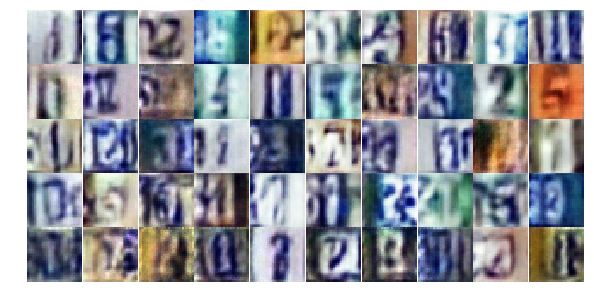

Epoch 6/25... Discriminator Loss: 0.5947... Generator Loss: 1.1120
Epoch 6/25... Discriminator Loss: 0.5632... Generator Loss: 1.2021
Epoch 6/25... Discriminator Loss: 0.6780... Generator Loss: 0.9540
Epoch 6/25... Discriminator Loss: 1.2981... Generator Loss: 3.0956
Epoch 6/25... Discriminator Loss: 1.5449... Generator Loss: 0.3618
Epoch 6/25... Discriminator Loss: 0.7399... Generator Loss: 0.9671
Epoch 6/25... Discriminator Loss: 0.6220... Generator Loss: 1.2614
Epoch 6/25... Discriminator Loss: 0.8571... Generator Loss: 0.8072
Epoch 6/25... Discriminator Loss: 0.4611... Generator Loss: 1.4987
Epoch 6/25... Discriminator Loss: 0.4901... Generator Loss: 1.6867


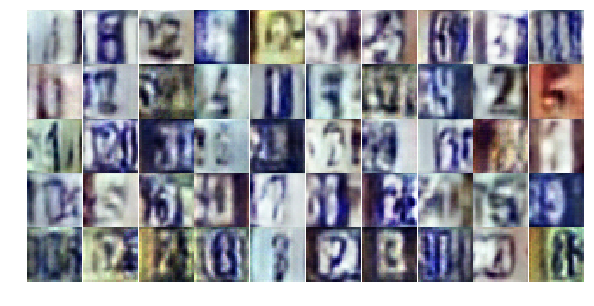

Epoch 6/25... Discriminator Loss: 0.8249... Generator Loss: 2.1966
Epoch 6/25... Discriminator Loss: 1.0627... Generator Loss: 2.0808
Epoch 6/25... Discriminator Loss: 1.6268... Generator Loss: 0.3227
Epoch 6/25... Discriminator Loss: 0.8425... Generator Loss: 0.8046
Epoch 6/25... Discriminator Loss: 0.4422... Generator Loss: 1.8651
Epoch 6/25... Discriminator Loss: 0.5546... Generator Loss: 1.3113
Epoch 6/25... Discriminator Loss: 0.6518... Generator Loss: 1.2775
Epoch 6/25... Discriminator Loss: 0.6577... Generator Loss: 1.0793
Epoch 6/25... Discriminator Loss: 0.5365... Generator Loss: 2.3460
Epoch 6/25... Discriminator Loss: 0.7703... Generator Loss: 0.8771


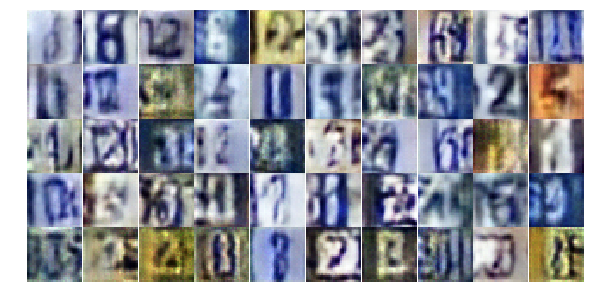

Epoch 6/25... Discriminator Loss: 0.7070... Generator Loss: 1.0255
Epoch 6/25... Discriminator Loss: 0.5923... Generator Loss: 1.2714
Epoch 6/25... Discriminator Loss: 1.1200... Generator Loss: 0.5585
Epoch 6/25... Discriminator Loss: 1.3402... Generator Loss: 0.4248
Epoch 6/25... Discriminator Loss: 0.5163... Generator Loss: 1.4988
Epoch 6/25... Discriminator Loss: 0.8144... Generator Loss: 0.8611
Epoch 6/25... Discriminator Loss: 0.5716... Generator Loss: 1.3710
Epoch 6/25... Discriminator Loss: 0.3338... Generator Loss: 1.6646
Epoch 6/25... Discriminator Loss: 0.5470... Generator Loss: 1.7430
Epoch 6/25... Discriminator Loss: 0.5103... Generator Loss: 1.4291


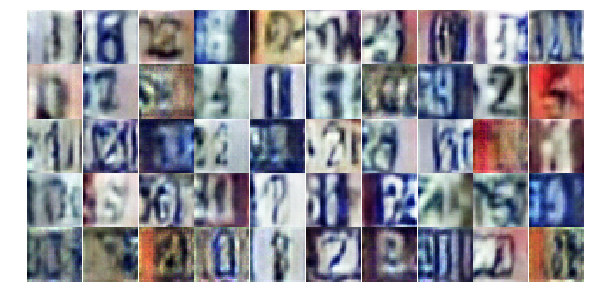

Epoch 6/25... Discriminator Loss: 0.6978... Generator Loss: 0.9902
Epoch 6/25... Discriminator Loss: 0.7170... Generator Loss: 1.9038
Epoch 6/25... Discriminator Loss: 1.0599... Generator Loss: 0.6324
Epoch 6/25... Discriminator Loss: 0.7498... Generator Loss: 0.9142
Epoch 6/25... Discriminator Loss: 0.9882... Generator Loss: 0.7059
Epoch 6/25... Discriminator Loss: 0.5565... Generator Loss: 1.4440
Epoch 6/25... Discriminator Loss: 0.5717... Generator Loss: 1.3880
Epoch 6/25... Discriminator Loss: 0.7265... Generator Loss: 0.9487
Epoch 6/25... Discriminator Loss: 0.5805... Generator Loss: 1.1595
Epoch 6/25... Discriminator Loss: 0.3621... Generator Loss: 1.8469


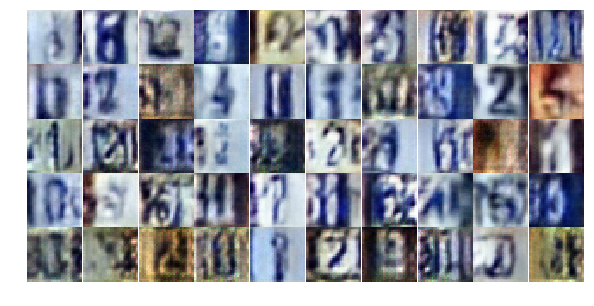

Epoch 6/25... Discriminator Loss: 1.2457... Generator Loss: 0.7641
Epoch 6/25... Discriminator Loss: 0.6888... Generator Loss: 1.2336
Epoch 6/25... Discriminator Loss: 0.7998... Generator Loss: 0.9313
Epoch 6/25... Discriminator Loss: 0.5295... Generator Loss: 1.4860
Epoch 6/25... Discriminator Loss: 0.5603... Generator Loss: 1.1679
Epoch 6/25... Discriminator Loss: 0.6014... Generator Loss: 1.1396
Epoch 6/25... Discriminator Loss: 0.8945... Generator Loss: 0.7334
Epoch 6/25... Discriminator Loss: 0.8650... Generator Loss: 0.7170
Epoch 6/25... Discriminator Loss: 1.0728... Generator Loss: 0.5872
Epoch 6/25... Discriminator Loss: 1.6022... Generator Loss: 0.3135


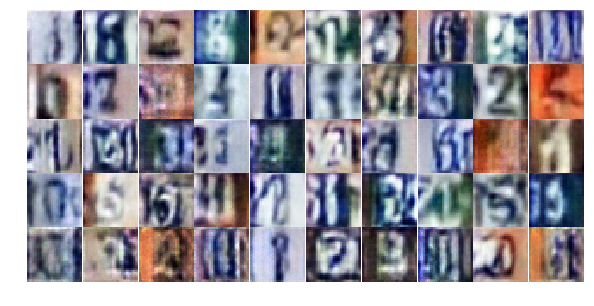

Epoch 6/25... Discriminator Loss: 0.4871... Generator Loss: 1.4731
Epoch 6/25... Discriminator Loss: 0.7680... Generator Loss: 0.8460
Epoch 6/25... Discriminator Loss: 1.1544... Generator Loss: 0.5204
Epoch 7/25... Discriminator Loss: 0.5197... Generator Loss: 1.4185
Epoch 7/25... Discriminator Loss: 0.7465... Generator Loss: 0.9889
Epoch 7/25... Discriminator Loss: 0.5436... Generator Loss: 1.1970
Epoch 7/25... Discriminator Loss: 0.4448... Generator Loss: 1.5152
Epoch 7/25... Discriminator Loss: 0.4400... Generator Loss: 1.4797
Epoch 7/25... Discriminator Loss: 1.7386... Generator Loss: 5.4648
Epoch 7/25... Discriminator Loss: 1.6792... Generator Loss: 0.3210


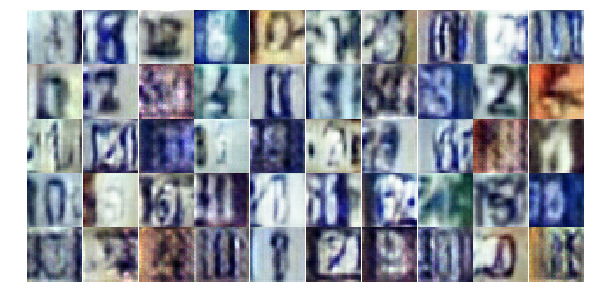

Epoch 7/25... Discriminator Loss: 0.8478... Generator Loss: 1.6047
Epoch 7/25... Discriminator Loss: 0.6845... Generator Loss: 1.0779
Epoch 7/25... Discriminator Loss: 0.9932... Generator Loss: 0.6127
Epoch 7/25... Discriminator Loss: 0.6814... Generator Loss: 2.2021
Epoch 7/25... Discriminator Loss: 0.6006... Generator Loss: 1.1857
Epoch 7/25... Discriminator Loss: 0.4629... Generator Loss: 1.5240
Epoch 7/25... Discriminator Loss: 1.2284... Generator Loss: 3.4749
Epoch 7/25... Discriminator Loss: 1.2110... Generator Loss: 2.9166
Epoch 7/25... Discriminator Loss: 0.5604... Generator Loss: 1.7702
Epoch 7/25... Discriminator Loss: 0.4427... Generator Loss: 1.7037


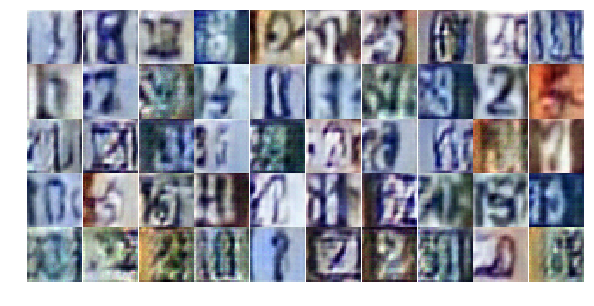

Epoch 7/25... Discriminator Loss: 1.2748... Generator Loss: 0.4534
Epoch 7/25... Discriminator Loss: 0.3465... Generator Loss: 1.8143
Epoch 7/25... Discriminator Loss: 0.8496... Generator Loss: 0.7452
Epoch 7/25... Discriminator Loss: 0.5487... Generator Loss: 2.0630
Epoch 7/25... Discriminator Loss: 0.5231... Generator Loss: 1.2186
Epoch 7/25... Discriminator Loss: 0.5537... Generator Loss: 1.8787
Epoch 7/25... Discriminator Loss: 0.4807... Generator Loss: 1.5031
Epoch 7/25... Discriminator Loss: 0.9442... Generator Loss: 0.7299
Epoch 7/25... Discriminator Loss: 0.4019... Generator Loss: 2.0022
Epoch 7/25... Discriminator Loss: 0.3957... Generator Loss: 1.9994


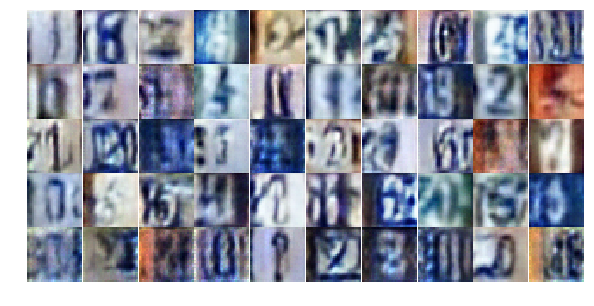

Epoch 7/25... Discriminator Loss: 0.7543... Generator Loss: 0.8959
Epoch 7/25... Discriminator Loss: 0.6083... Generator Loss: 1.0848
Epoch 7/25... Discriminator Loss: 1.0504... Generator Loss: 0.5864
Epoch 7/25... Discriminator Loss: 0.8055... Generator Loss: 0.9559
Epoch 7/25... Discriminator Loss: 0.7007... Generator Loss: 1.0302
Epoch 7/25... Discriminator Loss: 0.8896... Generator Loss: 0.8332
Epoch 7/25... Discriminator Loss: 0.4378... Generator Loss: 1.6379
Epoch 7/25... Discriminator Loss: 0.5063... Generator Loss: 1.3088
Epoch 7/25... Discriminator Loss: 1.0473... Generator Loss: 0.6000
Epoch 7/25... Discriminator Loss: 0.5792... Generator Loss: 2.3609


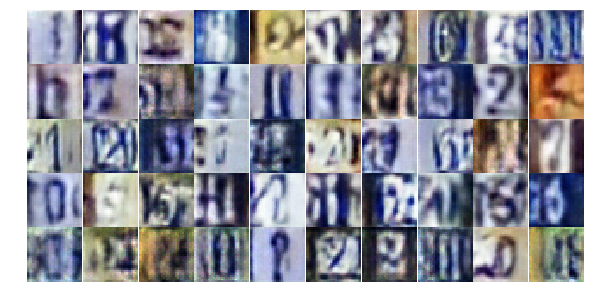

Epoch 7/25... Discriminator Loss: 1.2399... Generator Loss: 0.4590
Epoch 7/25... Discriminator Loss: 0.6602... Generator Loss: 1.2780
Epoch 7/25... Discriminator Loss: 0.5476... Generator Loss: 1.2624
Epoch 7/25... Discriminator Loss: 0.8726... Generator Loss: 2.7014
Epoch 7/25... Discriminator Loss: 0.7704... Generator Loss: 0.9380
Epoch 7/25... Discriminator Loss: 0.3886... Generator Loss: 1.6827
Epoch 7/25... Discriminator Loss: 0.2867... Generator Loss: 2.0042
Epoch 7/25... Discriminator Loss: 0.8112... Generator Loss: 1.3066
Epoch 7/25... Discriminator Loss: 0.3014... Generator Loss: 1.9090
Epoch 7/25... Discriminator Loss: 1.0978... Generator Loss: 1.8713


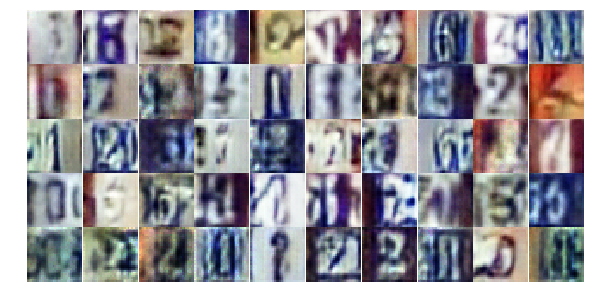

Epoch 7/25... Discriminator Loss: 0.3676... Generator Loss: 1.9218
Epoch 7/25... Discriminator Loss: 0.5588... Generator Loss: 1.4339
Epoch 7/25... Discriminator Loss: 0.7292... Generator Loss: 1.5283
Epoch 7/25... Discriminator Loss: 0.7587... Generator Loss: 0.8901
Epoch 7/25... Discriminator Loss: 0.4624... Generator Loss: 1.5118
Epoch 7/25... Discriminator Loss: 0.4632... Generator Loss: 1.4122
Epoch 7/25... Discriminator Loss: 1.9511... Generator Loss: 0.1973
Epoch 7/25... Discriminator Loss: 0.8494... Generator Loss: 1.1105
Epoch 7/25... Discriminator Loss: 0.9362... Generator Loss: 0.6957
Epoch 7/25... Discriminator Loss: 0.3836... Generator Loss: 1.5529


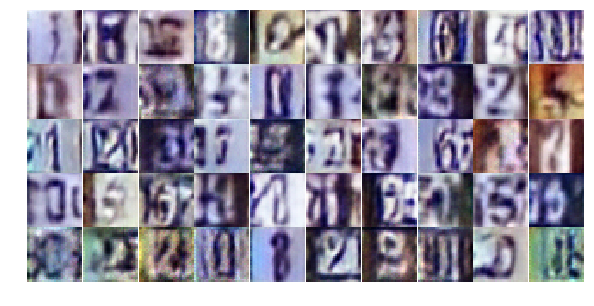

Epoch 7/25... Discriminator Loss: 1.0047... Generator Loss: 4.0277
Epoch 8/25... Discriminator Loss: 0.5088... Generator Loss: 1.3980
Epoch 8/25... Discriminator Loss: 0.9603... Generator Loss: 0.6257
Epoch 8/25... Discriminator Loss: 0.5582... Generator Loss: 1.3786
Epoch 8/25... Discriminator Loss: 0.5500... Generator Loss: 1.2332
Epoch 8/25... Discriminator Loss: 1.2223... Generator Loss: 0.4425
Epoch 8/25... Discriminator Loss: 0.7249... Generator Loss: 1.2129
Epoch 8/25... Discriminator Loss: 0.6960... Generator Loss: 2.7221
Epoch 8/25... Discriminator Loss: 0.8707... Generator Loss: 0.7622
Epoch 8/25... Discriminator Loss: 0.5719... Generator Loss: 1.1765


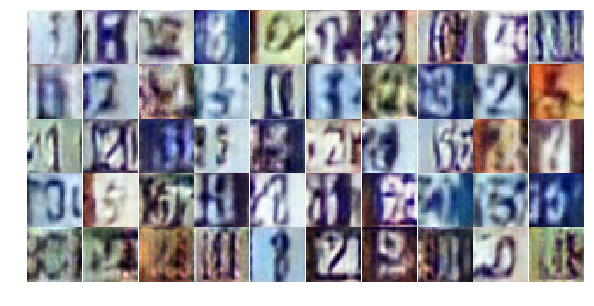

Epoch 8/25... Discriminator Loss: 0.4843... Generator Loss: 1.5932
Epoch 8/25... Discriminator Loss: 0.4044... Generator Loss: 1.4656
Epoch 8/25... Discriminator Loss: 0.6111... Generator Loss: 1.1011
Epoch 8/25... Discriminator Loss: 0.4393... Generator Loss: 1.7730
Epoch 8/25... Discriminator Loss: 0.6831... Generator Loss: 1.2339
Epoch 8/25... Discriminator Loss: 1.4055... Generator Loss: 3.3765
Epoch 8/25... Discriminator Loss: 1.0496... Generator Loss: 0.8074
Epoch 8/25... Discriminator Loss: 0.9820... Generator Loss: 0.7253
Epoch 8/25... Discriminator Loss: 0.7020... Generator Loss: 1.2357
Epoch 8/25... Discriminator Loss: 1.5890... Generator Loss: 0.3281


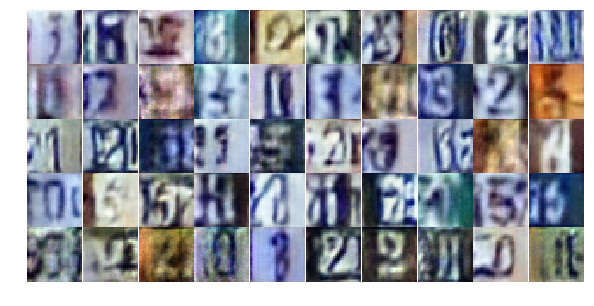

Epoch 8/25... Discriminator Loss: 0.4247... Generator Loss: 1.6597
Epoch 8/25... Discriminator Loss: 0.6297... Generator Loss: 1.0917
Epoch 8/25... Discriminator Loss: 0.7248... Generator Loss: 1.0215
Epoch 8/25... Discriminator Loss: 0.7508... Generator Loss: 1.0975
Epoch 8/25... Discriminator Loss: 0.4897... Generator Loss: 1.9274
Epoch 8/25... Discriminator Loss: 0.5839... Generator Loss: 1.4290
Epoch 8/25... Discriminator Loss: 0.5553... Generator Loss: 1.6515
Epoch 8/25... Discriminator Loss: 1.0343... Generator Loss: 3.2943
Epoch 8/25... Discriminator Loss: 1.1406... Generator Loss: 1.8398
Epoch 8/25... Discriminator Loss: 0.8169... Generator Loss: 0.8547


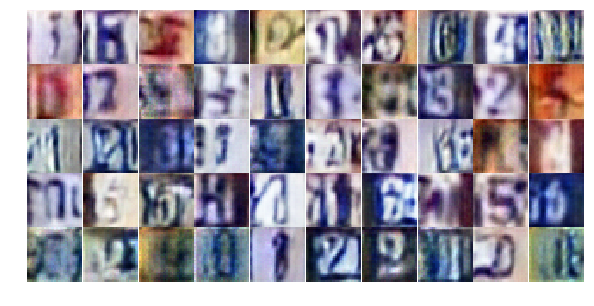

Epoch 8/25... Discriminator Loss: 0.5778... Generator Loss: 1.3880
Epoch 8/25... Discriminator Loss: 0.8905... Generator Loss: 0.7361
Epoch 8/25... Discriminator Loss: 0.6518... Generator Loss: 1.2857
Epoch 8/25... Discriminator Loss: 0.5841... Generator Loss: 1.3189
Epoch 8/25... Discriminator Loss: 0.5661... Generator Loss: 1.3103
Epoch 8/25... Discriminator Loss: 0.5524... Generator Loss: 1.2210
Epoch 8/25... Discriminator Loss: 0.5726... Generator Loss: 1.3743
Epoch 8/25... Discriminator Loss: 0.4512... Generator Loss: 1.5718
Epoch 8/25... Discriminator Loss: 0.5512... Generator Loss: 1.2940
Epoch 8/25... Discriminator Loss: 0.6061... Generator Loss: 1.0545


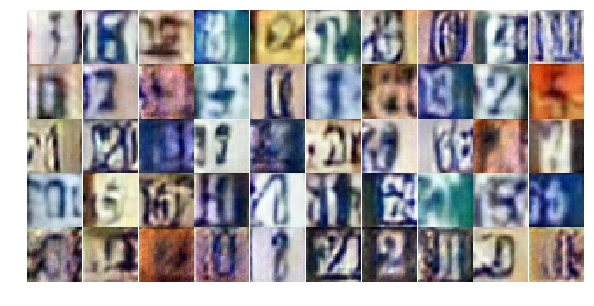

Epoch 8/25... Discriminator Loss: 0.4194... Generator Loss: 2.3588
Epoch 8/25... Discriminator Loss: 0.8410... Generator Loss: 0.8028
Epoch 8/25... Discriminator Loss: 0.6109... Generator Loss: 0.9958
Epoch 8/25... Discriminator Loss: 0.5095... Generator Loss: 1.2141
Epoch 8/25... Discriminator Loss: 1.4461... Generator Loss: 2.1836
Epoch 8/25... Discriminator Loss: 0.9374... Generator Loss: 0.7213
Epoch 8/25... Discriminator Loss: 0.6916... Generator Loss: 0.9025
Epoch 8/25... Discriminator Loss: 0.5202... Generator Loss: 1.4126
Epoch 8/25... Discriminator Loss: 0.5782... Generator Loss: 2.1279
Epoch 8/25... Discriminator Loss: 1.5959... Generator Loss: 4.1401


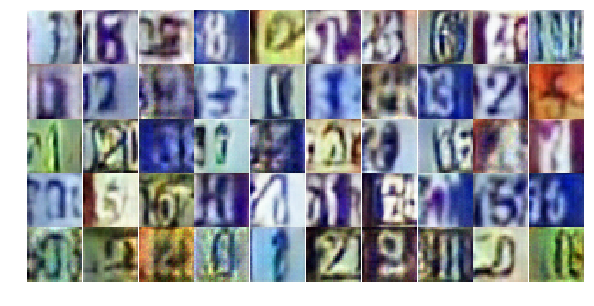

Epoch 8/25... Discriminator Loss: 0.6714... Generator Loss: 2.3754
Epoch 8/25... Discriminator Loss: 1.1161... Generator Loss: 0.5409
Epoch 8/25... Discriminator Loss: 0.6518... Generator Loss: 1.3426
Epoch 8/25... Discriminator Loss: 0.8326... Generator Loss: 0.7976
Epoch 8/25... Discriminator Loss: 0.5410... Generator Loss: 1.8726
Epoch 8/25... Discriminator Loss: 0.9779... Generator Loss: 0.7039
Epoch 8/25... Discriminator Loss: 0.4821... Generator Loss: 1.2933
Epoch 8/25... Discriminator Loss: 0.5378... Generator Loss: 2.0132
Epoch 9/25... Discriminator Loss: 0.9620... Generator Loss: 0.7763
Epoch 9/25... Discriminator Loss: 0.9364... Generator Loss: 0.6405


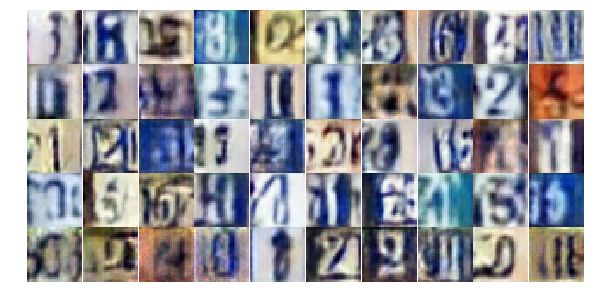

Epoch 9/25... Discriminator Loss: 0.8178... Generator Loss: 0.8938
Epoch 9/25... Discriminator Loss: 0.6086... Generator Loss: 1.3166
Epoch 9/25... Discriminator Loss: 0.9441... Generator Loss: 0.6675
Epoch 9/25... Discriminator Loss: 0.4239... Generator Loss: 1.9225
Epoch 9/25... Discriminator Loss: 0.7925... Generator Loss: 0.8547
Epoch 9/25... Discriminator Loss: 0.5383... Generator Loss: 2.8819
Epoch 9/25... Discriminator Loss: 0.5612... Generator Loss: 1.2667
Epoch 9/25... Discriminator Loss: 0.5617... Generator Loss: 1.1615
Epoch 9/25... Discriminator Loss: 0.5622... Generator Loss: 1.2900
Epoch 9/25... Discriminator Loss: 0.6577... Generator Loss: 1.0236


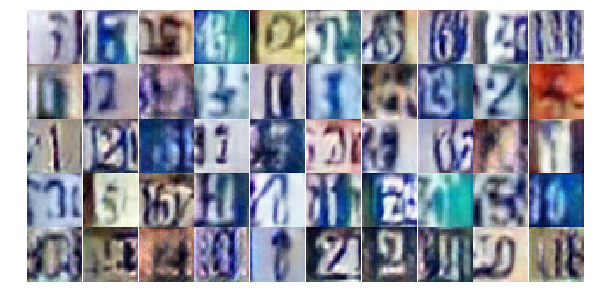

Epoch 9/25... Discriminator Loss: 0.6726... Generator Loss: 1.1249
Epoch 9/25... Discriminator Loss: 2.7877... Generator Loss: 0.1662
Epoch 9/25... Discriminator Loss: 1.0642... Generator Loss: 0.7546
Epoch 9/25... Discriminator Loss: 0.6598... Generator Loss: 1.0993
Epoch 9/25... Discriminator Loss: 0.6150... Generator Loss: 1.6224
Epoch 9/25... Discriminator Loss: 0.8668... Generator Loss: 0.7563
Epoch 9/25... Discriminator Loss: 1.0278... Generator Loss: 0.5797
Epoch 9/25... Discriminator Loss: 0.3268... Generator Loss: 1.7818
Epoch 9/25... Discriminator Loss: 1.0005... Generator Loss: 0.6280
Epoch 9/25... Discriminator Loss: 1.0702... Generator Loss: 0.5828


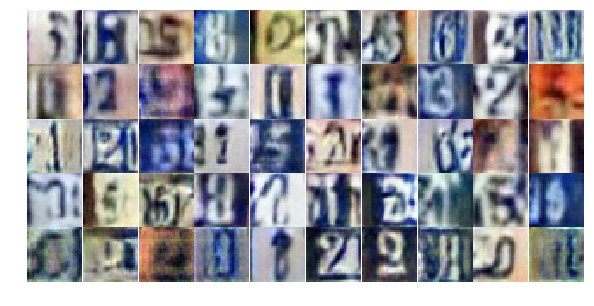

Epoch 9/25... Discriminator Loss: 0.8816... Generator Loss: 0.8324
Epoch 9/25... Discriminator Loss: 0.5942... Generator Loss: 1.6937
Epoch 9/25... Discriminator Loss: 0.8691... Generator Loss: 0.7754
Epoch 9/25... Discriminator Loss: 0.6523... Generator Loss: 1.7760
Epoch 9/25... Discriminator Loss: 0.5622... Generator Loss: 1.4248
Epoch 9/25... Discriminator Loss: 0.5935... Generator Loss: 1.1371
Epoch 9/25... Discriminator Loss: 0.4621... Generator Loss: 1.6426
Epoch 9/25... Discriminator Loss: 0.5123... Generator Loss: 1.4164
Epoch 9/25... Discriminator Loss: 0.5661... Generator Loss: 1.1133
Epoch 9/25... Discriminator Loss: 0.6900... Generator Loss: 0.9252


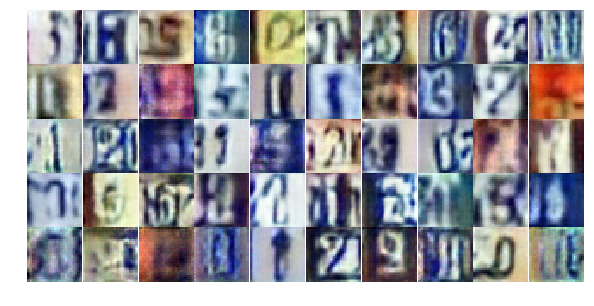

Epoch 9/25... Discriminator Loss: 0.5247... Generator Loss: 1.2145
Epoch 9/25... Discriminator Loss: 0.6211... Generator Loss: 1.3066
Epoch 9/25... Discriminator Loss: 0.8062... Generator Loss: 0.8444
Epoch 9/25... Discriminator Loss: 0.6270... Generator Loss: 1.6304
Epoch 9/25... Discriminator Loss: 0.5841... Generator Loss: 1.3043
Epoch 9/25... Discriminator Loss: 0.7081... Generator Loss: 1.0126
Epoch 9/25... Discriminator Loss: 0.5389... Generator Loss: 2.3019
Epoch 9/25... Discriminator Loss: 0.4955... Generator Loss: 1.4693
Epoch 9/25... Discriminator Loss: 0.6596... Generator Loss: 1.0537
Epoch 9/25... Discriminator Loss: 0.5536... Generator Loss: 1.1797


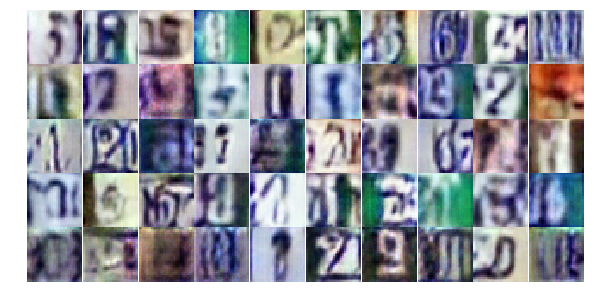

Epoch 9/25... Discriminator Loss: 0.5549... Generator Loss: 1.1600
Epoch 9/25... Discriminator Loss: 0.5604... Generator Loss: 1.1960
Epoch 9/25... Discriminator Loss: 0.4507... Generator Loss: 1.5805
Epoch 9/25... Discriminator Loss: 0.9232... Generator Loss: 2.5326
Epoch 9/25... Discriminator Loss: 0.5451... Generator Loss: 1.4608
Epoch 9/25... Discriminator Loss: 0.6228... Generator Loss: 1.2838
Epoch 9/25... Discriminator Loss: 0.7068... Generator Loss: 1.1113
Epoch 9/25... Discriminator Loss: 0.7460... Generator Loss: 0.8534
Epoch 9/25... Discriminator Loss: 0.6242... Generator Loss: 1.2830
Epoch 9/25... Discriminator Loss: 0.5911... Generator Loss: 1.6872


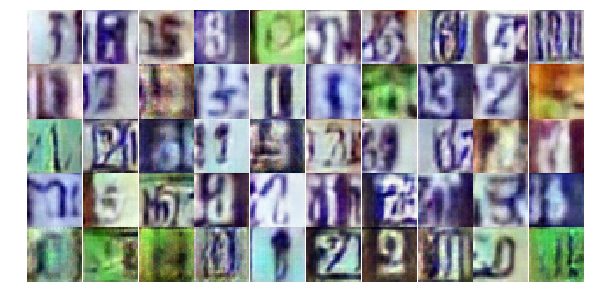

Epoch 9/25... Discriminator Loss: 0.8003... Generator Loss: 0.8253
Epoch 9/25... Discriminator Loss: 0.7144... Generator Loss: 2.1334
Epoch 9/25... Discriminator Loss: 0.7019... Generator Loss: 1.0590
Epoch 9/25... Discriminator Loss: 1.2068... Generator Loss: 0.4675
Epoch 9/25... Discriminator Loss: 0.5839... Generator Loss: 1.1976
Epoch 10/25... Discriminator Loss: 0.3960... Generator Loss: 1.7026
Epoch 10/25... Discriminator Loss: 0.4892... Generator Loss: 1.4109
Epoch 10/25... Discriminator Loss: 0.7623... Generator Loss: 0.8652
Epoch 10/25... Discriminator Loss: 0.5892... Generator Loss: 1.1713
Epoch 10/25... Discriminator Loss: 1.2180... Generator Loss: 0.5318


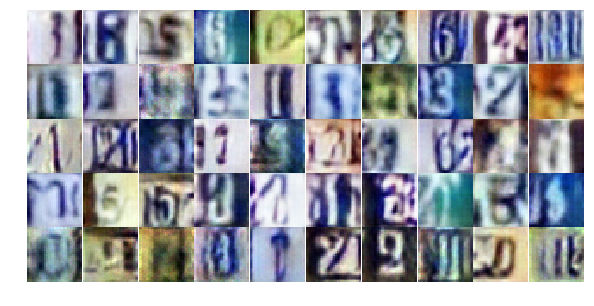

Epoch 10/25... Discriminator Loss: 0.9112... Generator Loss: 0.6909
Epoch 10/25... Discriminator Loss: 0.5119... Generator Loss: 1.2385
Epoch 10/25... Discriminator Loss: 0.6762... Generator Loss: 1.0210
Epoch 10/25... Discriminator Loss: 0.5685... Generator Loss: 1.2827
Epoch 10/25... Discriminator Loss: 0.5281... Generator Loss: 1.2735
Epoch 10/25... Discriminator Loss: 0.6981... Generator Loss: 0.9945
Epoch 10/25... Discriminator Loss: 0.3800... Generator Loss: 1.5364
Epoch 10/25... Discriminator Loss: 1.3912... Generator Loss: 0.4161
Epoch 10/25... Discriminator Loss: 2.1045... Generator Loss: 0.2259
Epoch 10/25... Discriminator Loss: 1.3328... Generator Loss: 2.1649


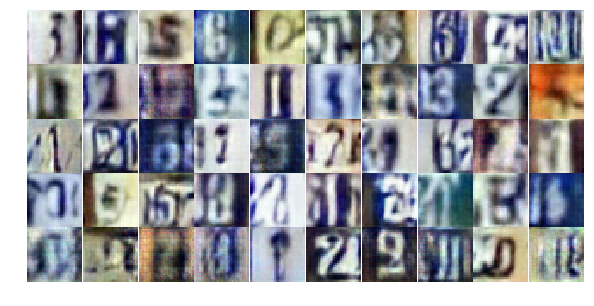

Epoch 10/25... Discriminator Loss: 0.7139... Generator Loss: 1.9635
Epoch 10/25... Discriminator Loss: 0.6501... Generator Loss: 1.1172
Epoch 10/25... Discriminator Loss: 0.8917... Generator Loss: 0.7343
Epoch 10/25... Discriminator Loss: 1.2443... Generator Loss: 0.4738
Epoch 10/25... Discriminator Loss: 0.6102... Generator Loss: 1.1410
Epoch 10/25... Discriminator Loss: 0.4437... Generator Loss: 1.6189
Epoch 10/25... Discriminator Loss: 0.8257... Generator Loss: 0.9284
Epoch 10/25... Discriminator Loss: 0.4521... Generator Loss: 1.5553
Epoch 10/25... Discriminator Loss: 0.5995... Generator Loss: 1.1990
Epoch 10/25... Discriminator Loss: 0.4290... Generator Loss: 2.4524


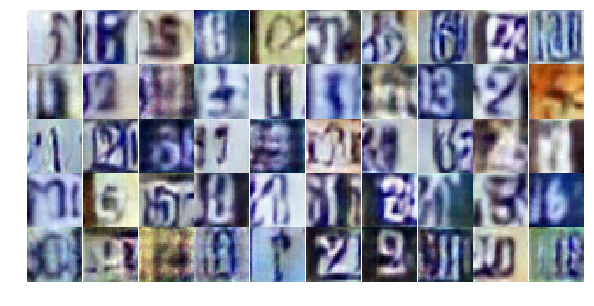

Epoch 10/25... Discriminator Loss: 1.1574... Generator Loss: 0.5083
Epoch 10/25... Discriminator Loss: 0.6799... Generator Loss: 1.1431
Epoch 10/25... Discriminator Loss: 0.4908... Generator Loss: 1.2528
Epoch 10/25... Discriminator Loss: 0.7258... Generator Loss: 2.4037
Epoch 10/25... Discriminator Loss: 1.3192... Generator Loss: 0.3954
Epoch 10/25... Discriminator Loss: 0.7225... Generator Loss: 0.9117
Epoch 10/25... Discriminator Loss: 0.3883... Generator Loss: 1.7599
Epoch 10/25... Discriminator Loss: 0.9380... Generator Loss: 0.7020
Epoch 10/25... Discriminator Loss: 0.8340... Generator Loss: 0.8326
Epoch 10/25... Discriminator Loss: 0.6972... Generator Loss: 1.0470


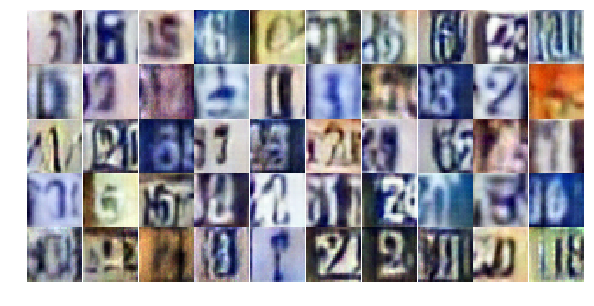

Epoch 10/25... Discriminator Loss: 0.7109... Generator Loss: 1.0041
Epoch 10/25... Discriminator Loss: 1.2605... Generator Loss: 0.5351
Epoch 10/25... Discriminator Loss: 0.7976... Generator Loss: 2.8926
Epoch 10/25... Discriminator Loss: 0.8133... Generator Loss: 1.8267
Epoch 10/25... Discriminator Loss: 0.7945... Generator Loss: 0.8420
Epoch 10/25... Discriminator Loss: 0.9065... Generator Loss: 0.7289
Epoch 10/25... Discriminator Loss: 0.8066... Generator Loss: 0.7800
Epoch 10/25... Discriminator Loss: 0.8414... Generator Loss: 0.7983
Epoch 10/25... Discriminator Loss: 0.7574... Generator Loss: 0.9247
Epoch 10/25... Discriminator Loss: 0.7461... Generator Loss: 2.6285


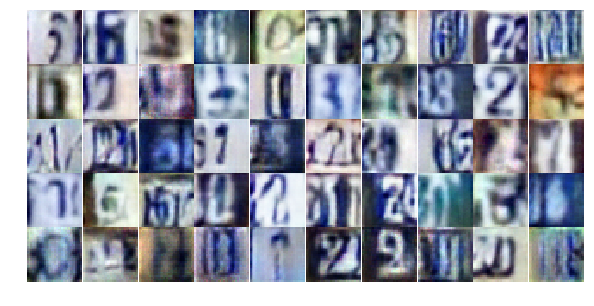

Epoch 10/25... Discriminator Loss: 1.2964... Generator Loss: 0.5152
Epoch 10/25... Discriminator Loss: 0.8397... Generator Loss: 0.9010
Epoch 10/25... Discriminator Loss: 0.6310... Generator Loss: 1.1330
Epoch 10/25... Discriminator Loss: 0.7084... Generator Loss: 0.9893
Epoch 10/25... Discriminator Loss: 0.6627... Generator Loss: 2.1766
Epoch 10/25... Discriminator Loss: 0.8079... Generator Loss: 0.8366
Epoch 10/25... Discriminator Loss: 0.6104... Generator Loss: 1.1109
Epoch 10/25... Discriminator Loss: 0.4519... Generator Loss: 1.5248
Epoch 10/25... Discriminator Loss: 0.7743... Generator Loss: 1.9004
Epoch 10/25... Discriminator Loss: 0.5764... Generator Loss: 1.2059


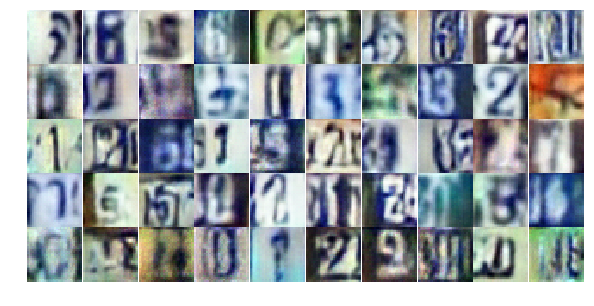

Epoch 10/25... Discriminator Loss: 0.5407... Generator Loss: 2.0181
Epoch 10/25... Discriminator Loss: 0.3873... Generator Loss: 1.5633
Epoch 10/25... Discriminator Loss: 0.6690... Generator Loss: 0.9446
Epoch 11/25... Discriminator Loss: 1.0524... Generator Loss: 0.6910
Epoch 11/25... Discriminator Loss: 0.6843... Generator Loss: 1.0316
Epoch 11/25... Discriminator Loss: 1.1395... Generator Loss: 0.4903
Epoch 11/25... Discriminator Loss: 1.0648... Generator Loss: 0.5770
Epoch 11/25... Discriminator Loss: 0.8276... Generator Loss: 0.8045
Epoch 11/25... Discriminator Loss: 1.6360... Generator Loss: 0.2884
Epoch 11/25... Discriminator Loss: 0.5093... Generator Loss: 1.6800


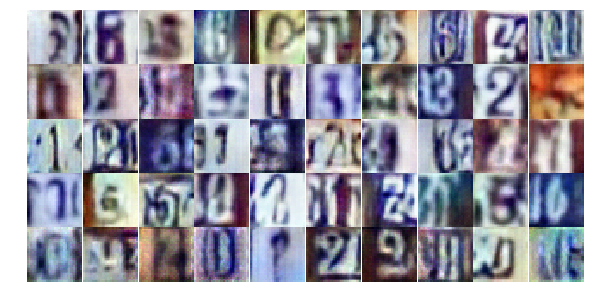

Epoch 11/25... Discriminator Loss: 0.4695... Generator Loss: 1.3943
Epoch 11/25... Discriminator Loss: 0.8742... Generator Loss: 0.8678
Epoch 11/25... Discriminator Loss: 0.6854... Generator Loss: 1.0179
Epoch 11/25... Discriminator Loss: 0.5466... Generator Loss: 1.1382
Epoch 11/25... Discriminator Loss: 0.8299... Generator Loss: 0.8018
Epoch 11/25... Discriminator Loss: 0.4533... Generator Loss: 1.5884
Epoch 11/25... Discriminator Loss: 0.6607... Generator Loss: 1.6168
Epoch 11/25... Discriminator Loss: 0.2741... Generator Loss: 2.4941
Epoch 11/25... Discriminator Loss: 0.7821... Generator Loss: 0.9200
Epoch 11/25... Discriminator Loss: 1.3026... Generator Loss: 0.4171


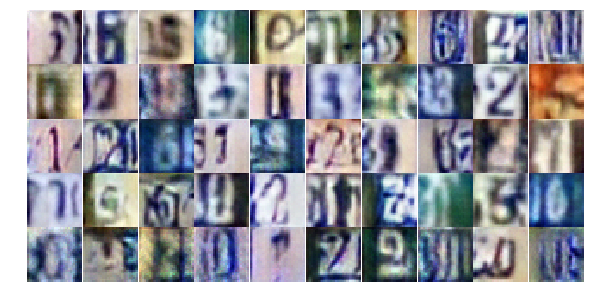

Epoch 11/25... Discriminator Loss: 0.6295... Generator Loss: 1.3969
Epoch 11/25... Discriminator Loss: 0.4006... Generator Loss: 1.8776
Epoch 11/25... Discriminator Loss: 1.1181... Generator Loss: 0.5496
Epoch 11/25... Discriminator Loss: 0.6172... Generator Loss: 1.2034
Epoch 11/25... Discriminator Loss: 0.4143... Generator Loss: 1.8330
Epoch 11/25... Discriminator Loss: 0.4788... Generator Loss: 1.5318
Epoch 11/25... Discriminator Loss: 0.5568... Generator Loss: 1.1223
Epoch 11/25... Discriminator Loss: 0.8328... Generator Loss: 0.8173
Epoch 11/25... Discriminator Loss: 0.4014... Generator Loss: 1.7647
Epoch 11/25... Discriminator Loss: 0.6289... Generator Loss: 1.0458


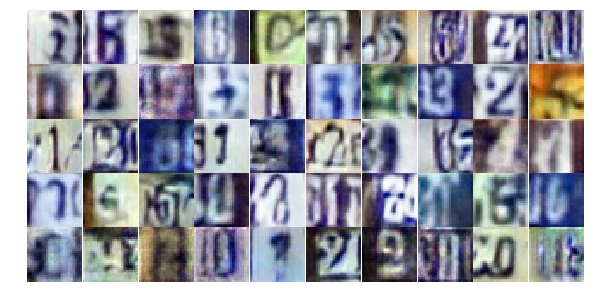

Epoch 11/25... Discriminator Loss: 1.2374... Generator Loss: 0.4768
Epoch 11/25... Discriminator Loss: 0.6072... Generator Loss: 1.1581
Epoch 11/25... Discriminator Loss: 0.7288... Generator Loss: 1.0360
Epoch 11/25... Discriminator Loss: 0.5116... Generator Loss: 1.2030
Epoch 11/25... Discriminator Loss: 0.6466... Generator Loss: 1.0330
Epoch 11/25... Discriminator Loss: 1.6090... Generator Loss: 0.3447
Epoch 11/25... Discriminator Loss: 1.2225... Generator Loss: 0.5432
Epoch 11/25... Discriminator Loss: 1.2852... Generator Loss: 0.4281
Epoch 11/25... Discriminator Loss: 0.6057... Generator Loss: 1.2029
Epoch 11/25... Discriminator Loss: 0.8779... Generator Loss: 0.8655


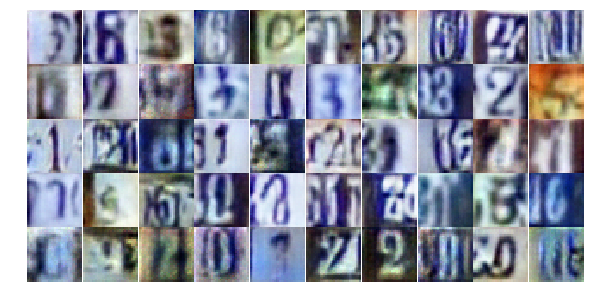

Epoch 11/25... Discriminator Loss: 0.4991... Generator Loss: 1.4243
Epoch 11/25... Discriminator Loss: 0.7187... Generator Loss: 0.9410
Epoch 11/25... Discriminator Loss: 0.7909... Generator Loss: 0.8665
Epoch 11/25... Discriminator Loss: 0.7044... Generator Loss: 1.0053
Epoch 11/25... Discriminator Loss: 0.7829... Generator Loss: 0.7806
Epoch 11/25... Discriminator Loss: 0.6460... Generator Loss: 1.7148
Epoch 11/25... Discriminator Loss: 1.7245... Generator Loss: 0.4163
Epoch 11/25... Discriminator Loss: 1.3541... Generator Loss: 3.8451
Epoch 11/25... Discriminator Loss: 1.4587... Generator Loss: 0.4226
Epoch 11/25... Discriminator Loss: 0.5115... Generator Loss: 1.2650


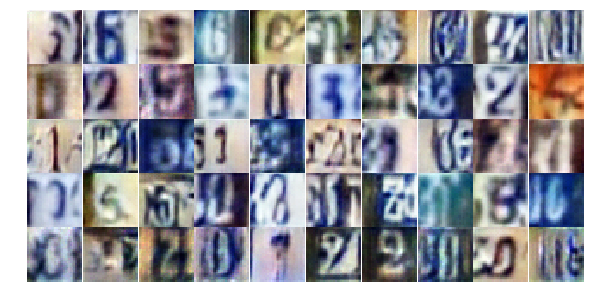

Epoch 11/25... Discriminator Loss: 0.7230... Generator Loss: 0.9063
Epoch 11/25... Discriminator Loss: 0.3144... Generator Loss: 2.2154
Epoch 11/25... Discriminator Loss: 0.6004... Generator Loss: 1.3673
Epoch 11/25... Discriminator Loss: 0.4922... Generator Loss: 1.3372
Epoch 11/25... Discriminator Loss: 1.3206... Generator Loss: 0.4353
Epoch 11/25... Discriminator Loss: 0.8847... Generator Loss: 0.7036
Epoch 11/25... Discriminator Loss: 1.5432... Generator Loss: 0.3684
Epoch 11/25... Discriminator Loss: 0.6189... Generator Loss: 1.2166
Epoch 11/25... Discriminator Loss: 0.7886... Generator Loss: 1.0158
Epoch 11/25... Discriminator Loss: 0.7371... Generator Loss: 1.1041


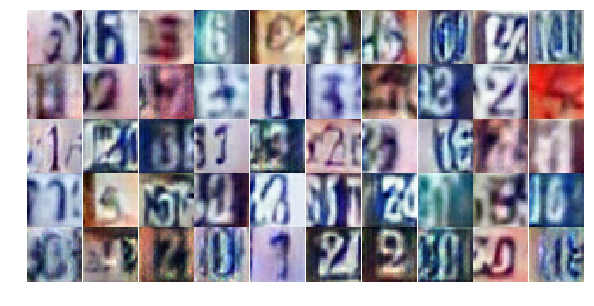

Epoch 12/25... Discriminator Loss: 0.8416... Generator Loss: 2.0109
Epoch 12/25... Discriminator Loss: 0.9018... Generator Loss: 0.7574
Epoch 12/25... Discriminator Loss: 0.7865... Generator Loss: 0.8346
Epoch 12/25... Discriminator Loss: 0.5366... Generator Loss: 1.4080
Epoch 12/25... Discriminator Loss: 0.5539... Generator Loss: 1.2276
Epoch 12/25... Discriminator Loss: 0.7768... Generator Loss: 0.8700
Epoch 12/25... Discriminator Loss: 0.6824... Generator Loss: 0.9663
Epoch 12/25... Discriminator Loss: 0.4745... Generator Loss: 1.5853
Epoch 12/25... Discriminator Loss: 0.6498... Generator Loss: 1.0809
Epoch 12/25... Discriminator Loss: 0.9535... Generator Loss: 0.7087


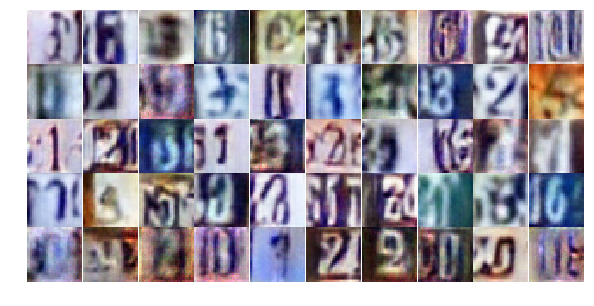

Epoch 12/25... Discriminator Loss: 0.5172... Generator Loss: 1.2087
Epoch 12/25... Discriminator Loss: 0.7632... Generator Loss: 0.9265
Epoch 12/25... Discriminator Loss: 0.5381... Generator Loss: 2.3359
Epoch 12/25... Discriminator Loss: 1.5113... Generator Loss: 1.2189
Epoch 12/25... Discriminator Loss: 0.5061... Generator Loss: 1.4866
Epoch 12/25... Discriminator Loss: 1.4960... Generator Loss: 1.2034
Epoch 12/25... Discriminator Loss: 1.7345... Generator Loss: 0.2889
Epoch 12/25... Discriminator Loss: 0.3735... Generator Loss: 1.9470
Epoch 12/25... Discriminator Loss: 0.4995... Generator Loss: 1.8895
Epoch 12/25... Discriminator Loss: 1.3052... Generator Loss: 0.4464


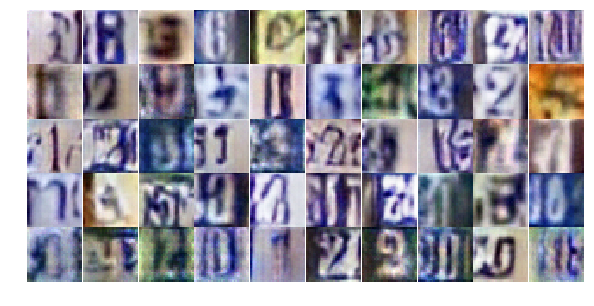

Epoch 12/25... Discriminator Loss: 0.4959... Generator Loss: 1.5068
Epoch 12/25... Discriminator Loss: 0.4804... Generator Loss: 1.7038
Epoch 12/25... Discriminator Loss: 0.6843... Generator Loss: 0.9972
Epoch 12/25... Discriminator Loss: 0.4222... Generator Loss: 1.5114
Epoch 12/25... Discriminator Loss: 0.3524... Generator Loss: 1.7841
Epoch 12/25... Discriminator Loss: 0.5784... Generator Loss: 1.2435
Epoch 12/25... Discriminator Loss: 0.5976... Generator Loss: 1.1001
Epoch 12/25... Discriminator Loss: 0.2969... Generator Loss: 2.0587
Epoch 12/25... Discriminator Loss: 0.5295... Generator Loss: 1.2527
Epoch 12/25... Discriminator Loss: 0.7179... Generator Loss: 1.0069


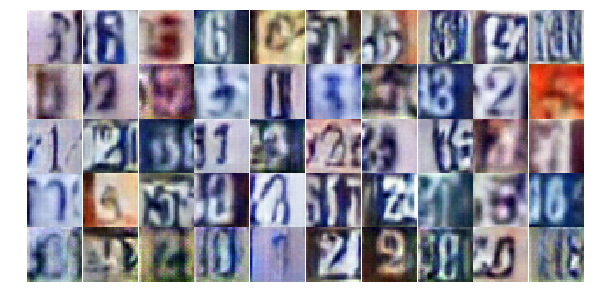

Epoch 12/25... Discriminator Loss: 0.5625... Generator Loss: 1.1576
Epoch 12/25... Discriminator Loss: 0.9181... Generator Loss: 0.6873
Epoch 12/25... Discriminator Loss: 0.8908... Generator Loss: 0.7261
Epoch 12/25... Discriminator Loss: 1.4584... Generator Loss: 0.3776
Epoch 12/25... Discriminator Loss: 0.6890... Generator Loss: 1.0865
Epoch 12/25... Discriminator Loss: 1.0127... Generator Loss: 0.6995
Epoch 12/25... Discriminator Loss: 1.2452... Generator Loss: 0.4831
Epoch 12/25... Discriminator Loss: 0.7411... Generator Loss: 1.1025
Epoch 12/25... Discriminator Loss: 0.6452... Generator Loss: 0.9978
Epoch 12/25... Discriminator Loss: 0.2637... Generator Loss: 1.9591


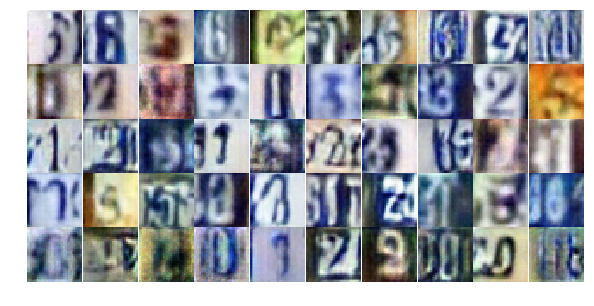

Epoch 12/25... Discriminator Loss: 0.8375... Generator Loss: 0.8207
Epoch 12/25... Discriminator Loss: 0.4855... Generator Loss: 1.2691
Epoch 12/25... Discriminator Loss: 0.4472... Generator Loss: 1.3671
Epoch 12/25... Discriminator Loss: 0.6319... Generator Loss: 1.2299
Epoch 12/25... Discriminator Loss: 1.9132... Generator Loss: 0.3316
Epoch 12/25... Discriminator Loss: 1.1728... Generator Loss: 0.5603
Epoch 12/25... Discriminator Loss: 0.9555... Generator Loss: 0.7332
Epoch 12/25... Discriminator Loss: 0.7728... Generator Loss: 0.8663
Epoch 12/25... Discriminator Loss: 0.4910... Generator Loss: 1.5880
Epoch 12/25... Discriminator Loss: 0.6384... Generator Loss: 1.2054


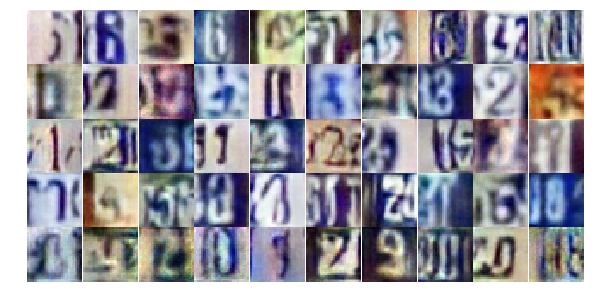

Epoch 12/25... Discriminator Loss: 0.8796... Generator Loss: 0.7201
Epoch 12/25... Discriminator Loss: 0.6983... Generator Loss: 0.9862
Epoch 12/25... Discriminator Loss: 0.7464... Generator Loss: 0.8506
Epoch 12/25... Discriminator Loss: 1.6075... Generator Loss: 0.3271
Epoch 12/25... Discriminator Loss: 0.4411... Generator Loss: 1.4384
Epoch 12/25... Discriminator Loss: 0.6397... Generator Loss: 1.9643
Epoch 12/25... Discriminator Loss: 0.7474... Generator Loss: 0.9447
Epoch 13/25... Discriminator Loss: 0.5960... Generator Loss: 1.1366
Epoch 13/25... Discriminator Loss: 0.4845... Generator Loss: 1.4346
Epoch 13/25... Discriminator Loss: 0.8529... Generator Loss: 0.7887


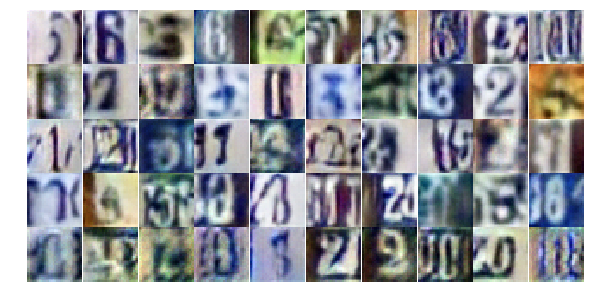

Epoch 13/25... Discriminator Loss: 0.6936... Generator Loss: 0.9211
Epoch 13/25... Discriminator Loss: 0.4954... Generator Loss: 2.0834
Epoch 13/25... Discriminator Loss: 1.6599... Generator Loss: 0.3044
Epoch 13/25... Discriminator Loss: 1.3223... Generator Loss: 0.4827
Epoch 13/25... Discriminator Loss: 0.5386... Generator Loss: 1.3234
Epoch 13/25... Discriminator Loss: 0.5240... Generator Loss: 1.2370
Epoch 13/25... Discriminator Loss: 0.3384... Generator Loss: 2.2255
Epoch 13/25... Discriminator Loss: 0.7522... Generator Loss: 0.8368
Epoch 13/25... Discriminator Loss: 0.5870... Generator Loss: 1.0975
Epoch 13/25... Discriminator Loss: 0.6635... Generator Loss: 0.9964


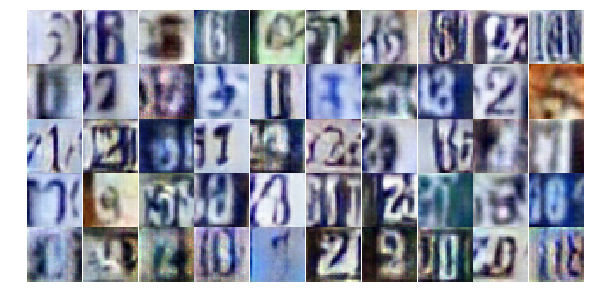

Epoch 13/25... Discriminator Loss: 0.6593... Generator Loss: 1.0577
Epoch 13/25... Discriminator Loss: 0.4482... Generator Loss: 1.4223
Epoch 13/25... Discriminator Loss: 1.0336... Generator Loss: 0.5981
Epoch 13/25... Discriminator Loss: 0.5190... Generator Loss: 1.2736
Epoch 13/25... Discriminator Loss: 0.5760... Generator Loss: 1.3746
Epoch 13/25... Discriminator Loss: 1.0192... Generator Loss: 0.7819
Epoch 13/25... Discriminator Loss: 1.0478... Generator Loss: 0.6830
Epoch 13/25... Discriminator Loss: 1.3097... Generator Loss: 0.4226
Epoch 13/25... Discriminator Loss: 0.5036... Generator Loss: 1.6185
Epoch 13/25... Discriminator Loss: 0.8628... Generator Loss: 0.7450


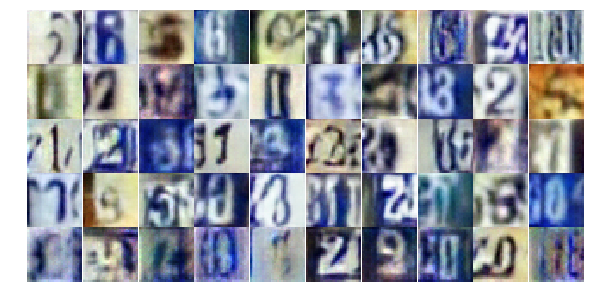

Epoch 13/25... Discriminator Loss: 0.8337... Generator Loss: 0.7906
Epoch 13/25... Discriminator Loss: 0.9188... Generator Loss: 0.8016
Epoch 13/25... Discriminator Loss: 0.6526... Generator Loss: 1.1529
Epoch 13/25... Discriminator Loss: 0.5745... Generator Loss: 1.1583
Epoch 13/25... Discriminator Loss: 0.8243... Generator Loss: 0.8244
Epoch 13/25... Discriminator Loss: 0.8539... Generator Loss: 0.8154
Epoch 13/25... Discriminator Loss: 0.7582... Generator Loss: 1.3202
Epoch 13/25... Discriminator Loss: 0.4604... Generator Loss: 1.4755
Epoch 13/25... Discriminator Loss: 0.5252... Generator Loss: 1.4210
Epoch 13/25... Discriminator Loss: 0.5730... Generator Loss: 1.2091


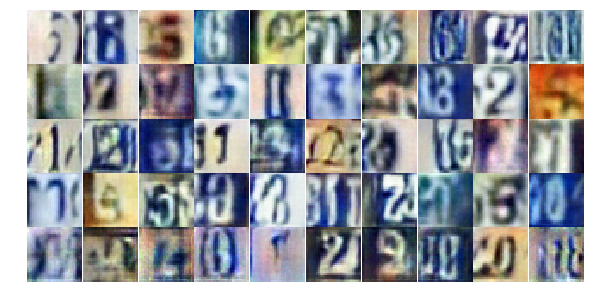

Epoch 13/25... Discriminator Loss: 1.0293... Generator Loss: 0.6429
Epoch 13/25... Discriminator Loss: 1.2860... Generator Loss: 0.4624
Epoch 13/25... Discriminator Loss: 1.6434... Generator Loss: 0.3675
Epoch 13/25... Discriminator Loss: 1.0160... Generator Loss: 0.7417
Epoch 13/25... Discriminator Loss: 0.7521... Generator Loss: 1.0797
Epoch 13/25... Discriminator Loss: 0.6412... Generator Loss: 1.0795
Epoch 13/25... Discriminator Loss: 0.4726... Generator Loss: 1.3936
Epoch 13/25... Discriminator Loss: 0.7523... Generator Loss: 0.9594
Epoch 13/25... Discriminator Loss: 0.5289... Generator Loss: 1.2366
Epoch 13/25... Discriminator Loss: 0.7720... Generator Loss: 0.8748


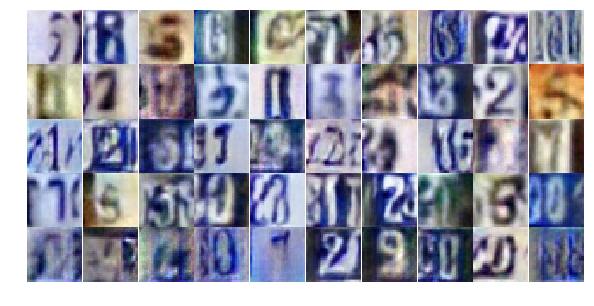

Epoch 13/25... Discriminator Loss: 0.4968... Generator Loss: 1.4986
Epoch 13/25... Discriminator Loss: 0.7090... Generator Loss: 1.1879
Epoch 13/25... Discriminator Loss: 0.9336... Generator Loss: 0.8429
Epoch 13/25... Discriminator Loss: 0.6462... Generator Loss: 1.2886
Epoch 13/25... Discriminator Loss: 1.2052... Generator Loss: 0.5034
Epoch 13/25... Discriminator Loss: 0.5953... Generator Loss: 1.2159
Epoch 13/25... Discriminator Loss: 0.5760... Generator Loss: 1.2534
Epoch 13/25... Discriminator Loss: 0.5246... Generator Loss: 1.3634
Epoch 13/25... Discriminator Loss: 1.1658... Generator Loss: 0.5219
Epoch 13/25... Discriminator Loss: 0.3341... Generator Loss: 1.9413


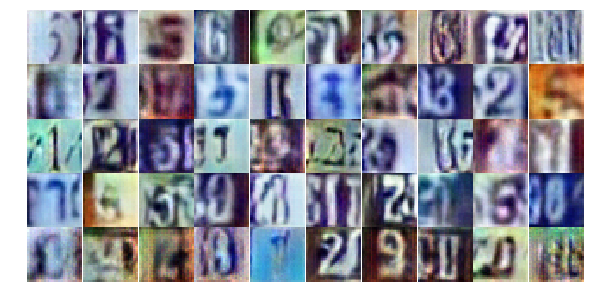

Epoch 13/25... Discriminator Loss: 0.4779... Generator Loss: 3.0485
Epoch 13/25... Discriminator Loss: 1.3520... Generator Loss: 0.4426
Epoch 13/25... Discriminator Loss: 0.7573... Generator Loss: 0.9714
Epoch 13/25... Discriminator Loss: 0.6979... Generator Loss: 0.9413
Epoch 14/25... Discriminator Loss: 1.0504... Generator Loss: 0.5814
Epoch 14/25... Discriminator Loss: 0.7043... Generator Loss: 0.9491
Epoch 14/25... Discriminator Loss: 0.8664... Generator Loss: 0.9454
Epoch 14/25... Discriminator Loss: 0.6654... Generator Loss: 1.2624
Epoch 14/25... Discriminator Loss: 0.5846... Generator Loss: 1.0876
Epoch 14/25... Discriminator Loss: 0.8281... Generator Loss: 0.8735


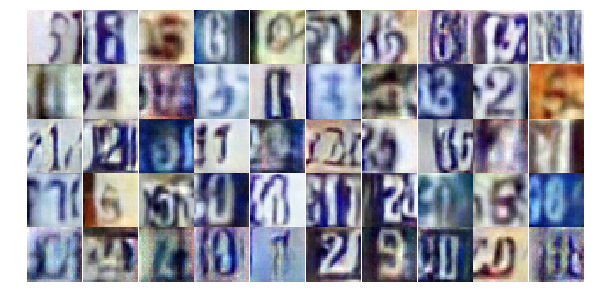

Epoch 14/25... Discriminator Loss: 0.5599... Generator Loss: 1.6452
Epoch 14/25... Discriminator Loss: 1.1507... Generator Loss: 0.5453
Epoch 14/25... Discriminator Loss: 0.5157... Generator Loss: 1.2683
Epoch 14/25... Discriminator Loss: 0.5263... Generator Loss: 1.3714
Epoch 14/25... Discriminator Loss: 0.9195... Generator Loss: 0.6818
Epoch 14/25... Discriminator Loss: 0.4821... Generator Loss: 1.1487
Epoch 14/25... Discriminator Loss: 0.3781... Generator Loss: 2.1253
Epoch 14/25... Discriminator Loss: 1.0643... Generator Loss: 0.6063
Epoch 14/25... Discriminator Loss: 1.5821... Generator Loss: 0.3206
Epoch 14/25... Discriminator Loss: 2.3143... Generator Loss: 0.2219


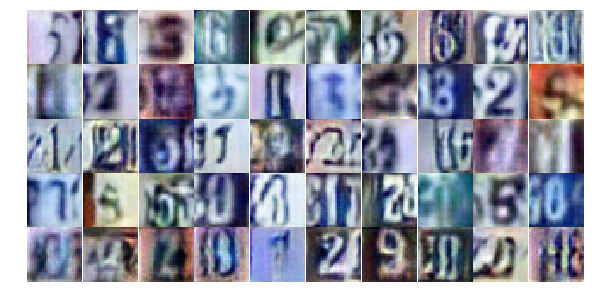

Epoch 14/25... Discriminator Loss: 0.6584... Generator Loss: 1.1093
Epoch 14/25... Discriminator Loss: 0.8669... Generator Loss: 3.0993
Epoch 14/25... Discriminator Loss: 0.8573... Generator Loss: 0.8476
Epoch 14/25... Discriminator Loss: 0.3262... Generator Loss: 2.0491
Epoch 14/25... Discriminator Loss: 1.0895... Generator Loss: 0.5891
Epoch 14/25... Discriminator Loss: 0.9512... Generator Loss: 0.7204
Epoch 14/25... Discriminator Loss: 0.7115... Generator Loss: 0.9255
Epoch 14/25... Discriminator Loss: 0.6057... Generator Loss: 1.1422
Epoch 14/25... Discriminator Loss: 0.6016... Generator Loss: 1.1684
Epoch 14/25... Discriminator Loss: 0.5046... Generator Loss: 1.3910


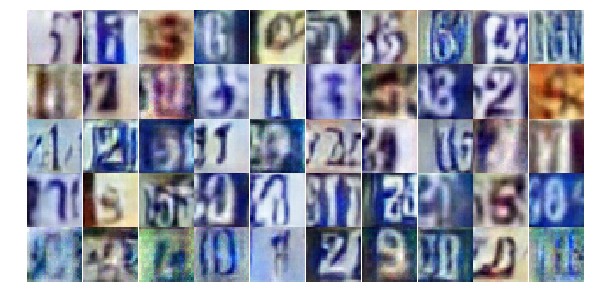

Epoch 14/25... Discriminator Loss: 1.3677... Generator Loss: 0.4803
Epoch 14/25... Discriminator Loss: 0.5117... Generator Loss: 1.3548
Epoch 14/25... Discriminator Loss: 0.4544... Generator Loss: 1.3916
Epoch 14/25... Discriminator Loss: 0.4122... Generator Loss: 1.6819
Epoch 14/25... Discriminator Loss: 0.8301... Generator Loss: 0.9117
Epoch 14/25... Discriminator Loss: 0.6187... Generator Loss: 1.1383
Epoch 14/25... Discriminator Loss: 0.7091... Generator Loss: 0.9890
Epoch 14/25... Discriminator Loss: 0.3451... Generator Loss: 1.8496
Epoch 14/25... Discriminator Loss: 0.4973... Generator Loss: 2.1256
Epoch 14/25... Discriminator Loss: 0.9166... Generator Loss: 0.7269


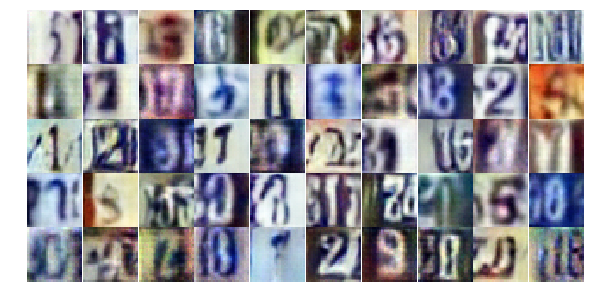

Epoch 14/25... Discriminator Loss: 1.3021... Generator Loss: 0.4323
Epoch 14/25... Discriminator Loss: 0.6824... Generator Loss: 1.4954
Epoch 14/25... Discriminator Loss: 1.0475... Generator Loss: 0.6601
Epoch 14/25... Discriminator Loss: 0.7853... Generator Loss: 1.0770
Epoch 14/25... Discriminator Loss: 1.1086... Generator Loss: 0.5720
Epoch 14/25... Discriminator Loss: 0.6737... Generator Loss: 1.1814
Epoch 14/25... Discriminator Loss: 0.5223... Generator Loss: 1.3063
Epoch 14/25... Discriminator Loss: 0.4674... Generator Loss: 1.6210
Epoch 14/25... Discriminator Loss: 1.7128... Generator Loss: 0.2782
Epoch 14/25... Discriminator Loss: 1.2167... Generator Loss: 0.6552


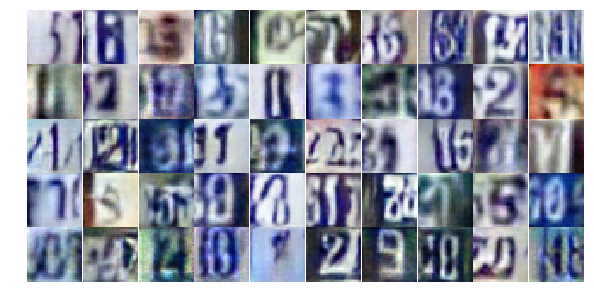

Epoch 14/25... Discriminator Loss: 0.9330... Generator Loss: 0.9679
Epoch 14/25... Discriminator Loss: 1.5736... Generator Loss: 0.3139
Epoch 14/25... Discriminator Loss: 0.5945... Generator Loss: 1.1393
Epoch 14/25... Discriminator Loss: 1.1803... Generator Loss: 0.5107
Epoch 14/25... Discriminator Loss: 0.5790... Generator Loss: 1.1715
Epoch 14/25... Discriminator Loss: 0.7267... Generator Loss: 1.0089
Epoch 14/25... Discriminator Loss: 0.6016... Generator Loss: 1.9323
Epoch 14/25... Discriminator Loss: 0.8374... Generator Loss: 0.7930
Epoch 14/25... Discriminator Loss: 0.7308... Generator Loss: 1.1704
Epoch 14/25... Discriminator Loss: 1.5316... Generator Loss: 0.3468


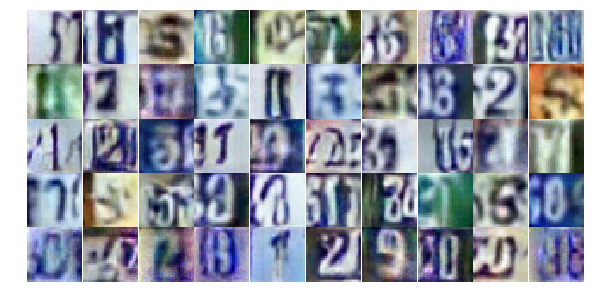

Epoch 14/25... Discriminator Loss: 0.8427... Generator Loss: 0.8327
Epoch 14/25... Discriminator Loss: 1.3430... Generator Loss: 2.7372
Epoch 15/25... Discriminator Loss: 0.6762... Generator Loss: 2.8547
Epoch 15/25... Discriminator Loss: 0.5668... Generator Loss: 1.3477
Epoch 15/25... Discriminator Loss: 0.6619... Generator Loss: 1.1017
Epoch 15/25... Discriminator Loss: 0.8873... Generator Loss: 0.8046
Epoch 15/25... Discriminator Loss: 0.9160... Generator Loss: 0.7173
Epoch 15/25... Discriminator Loss: 0.6800... Generator Loss: 0.9721
Epoch 15/25... Discriminator Loss: 1.4208... Generator Loss: 0.3715
Epoch 15/25... Discriminator Loss: 0.6539... Generator Loss: 1.0600


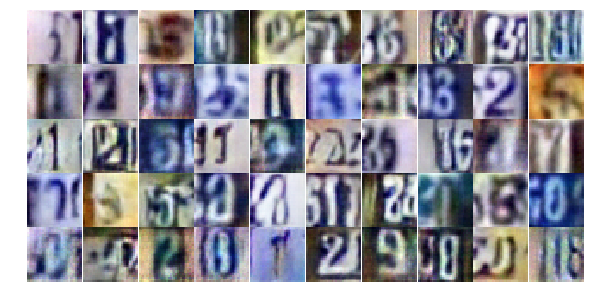

Epoch 15/25... Discriminator Loss: 0.8833... Generator Loss: 0.8828
Epoch 15/25... Discriminator Loss: 0.8603... Generator Loss: 1.8705
Epoch 15/25... Discriminator Loss: 0.7525... Generator Loss: 1.0636
Epoch 15/25... Discriminator Loss: 0.7814... Generator Loss: 0.8620
Epoch 15/25... Discriminator Loss: 0.6665... Generator Loss: 1.2348
Epoch 15/25... Discriminator Loss: 0.3747... Generator Loss: 1.7793
Epoch 15/25... Discriminator Loss: 1.3355... Generator Loss: 0.4547
Epoch 15/25... Discriminator Loss: 0.7025... Generator Loss: 1.4372
Epoch 15/25... Discriminator Loss: 0.6608... Generator Loss: 3.2475
Epoch 15/25... Discriminator Loss: 2.0241... Generator Loss: 0.2628


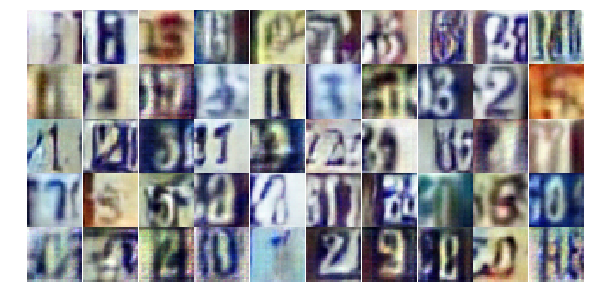

Epoch 15/25... Discriminator Loss: 1.0761... Generator Loss: 1.1362
Epoch 15/25... Discriminator Loss: 0.7455... Generator Loss: 0.9168
Epoch 15/25... Discriminator Loss: 0.4458... Generator Loss: 1.8257
Epoch 15/25... Discriminator Loss: 0.7353... Generator Loss: 1.0056
Epoch 15/25... Discriminator Loss: 0.8789... Generator Loss: 0.9911
Epoch 15/25... Discriminator Loss: 0.8335... Generator Loss: 0.8201
Epoch 15/25... Discriminator Loss: 0.9197... Generator Loss: 0.7203
Epoch 15/25... Discriminator Loss: 0.8755... Generator Loss: 0.7852
Epoch 15/25... Discriminator Loss: 0.4724... Generator Loss: 1.3156
Epoch 15/25... Discriminator Loss: 1.4044... Generator Loss: 0.4030


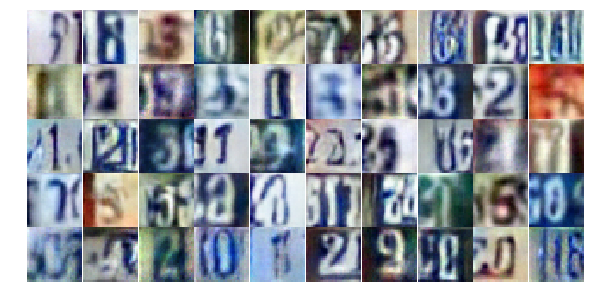

Epoch 15/25... Discriminator Loss: 0.6717... Generator Loss: 1.0509
Epoch 15/25... Discriminator Loss: 0.6022... Generator Loss: 1.1709
Epoch 15/25... Discriminator Loss: 0.4632... Generator Loss: 1.3358
Epoch 15/25... Discriminator Loss: 0.8792... Generator Loss: 0.7132
Epoch 15/25... Discriminator Loss: 0.7010... Generator Loss: 1.0462
Epoch 15/25... Discriminator Loss: 1.0526... Generator Loss: 2.8204
Epoch 15/25... Discriminator Loss: 0.4701... Generator Loss: 1.6092
Epoch 15/25... Discriminator Loss: 0.8211... Generator Loss: 0.7916
Epoch 15/25... Discriminator Loss: 0.4640... Generator Loss: 1.4592
Epoch 15/25... Discriminator Loss: 0.6573... Generator Loss: 1.4626


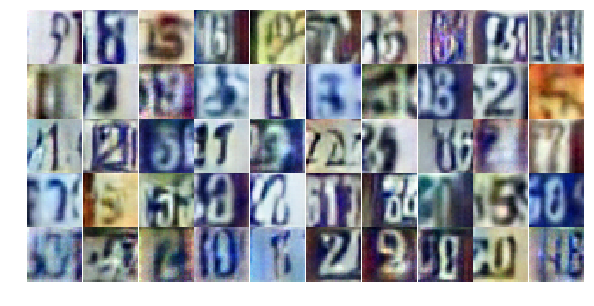

Epoch 15/25... Discriminator Loss: 0.9861... Generator Loss: 0.6397
Epoch 15/25... Discriminator Loss: 1.2286... Generator Loss: 0.5644
Epoch 15/25... Discriminator Loss: 0.7877... Generator Loss: 0.8169
Epoch 15/25... Discriminator Loss: 0.3854... Generator Loss: 1.6330
Epoch 15/25... Discriminator Loss: 0.5414... Generator Loss: 1.2425
Epoch 15/25... Discriminator Loss: 1.5558... Generator Loss: 0.4176
Epoch 15/25... Discriminator Loss: 0.4408... Generator Loss: 1.5279
Epoch 15/25... Discriminator Loss: 0.9993... Generator Loss: 0.7248
Epoch 15/25... Discriminator Loss: 1.2183... Generator Loss: 0.4703
Epoch 15/25... Discriminator Loss: 0.6836... Generator Loss: 1.7836


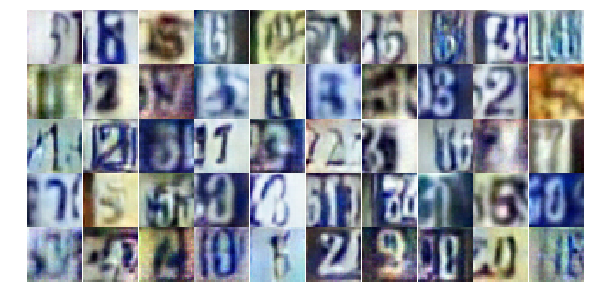

Epoch 15/25... Discriminator Loss: 1.0844... Generator Loss: 0.5717
Epoch 15/25... Discriminator Loss: 0.7721... Generator Loss: 1.0144
Epoch 15/25... Discriminator Loss: 0.5648... Generator Loss: 1.1244
Epoch 15/25... Discriminator Loss: 1.2509... Generator Loss: 0.7305
Epoch 15/25... Discriminator Loss: 0.5621... Generator Loss: 1.2023
Epoch 15/25... Discriminator Loss: 0.9248... Generator Loss: 0.8138
Epoch 15/25... Discriminator Loss: 1.0061... Generator Loss: 0.7245
Epoch 15/25... Discriminator Loss: 0.4371... Generator Loss: 1.6944
Epoch 15/25... Discriminator Loss: 1.5350... Generator Loss: 0.3679
Epoch 16/25... Discriminator Loss: 1.6136... Generator Loss: 0.3662


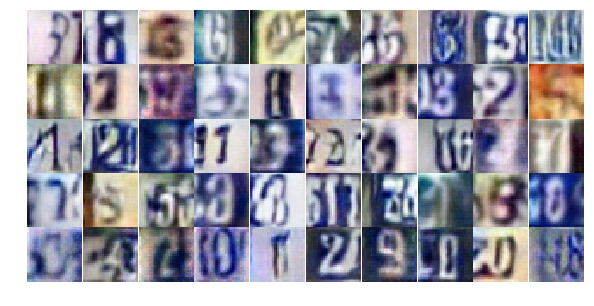

Epoch 16/25... Discriminator Loss: 0.7110... Generator Loss: 1.0744
Epoch 16/25... Discriminator Loss: 0.7834... Generator Loss: 0.8905
Epoch 16/25... Discriminator Loss: 0.9008... Generator Loss: 0.7428
Epoch 16/25... Discriminator Loss: 0.6621... Generator Loss: 1.4711
Epoch 16/25... Discriminator Loss: 0.5192... Generator Loss: 1.7903
Epoch 16/25... Discriminator Loss: 0.5374... Generator Loss: 1.6888
Epoch 16/25... Discriminator Loss: 1.8009... Generator Loss: 0.2448
Epoch 16/25... Discriminator Loss: 0.8396... Generator Loss: 0.8588
Epoch 16/25... Discriminator Loss: 0.4382... Generator Loss: 1.4258
Epoch 16/25... Discriminator Loss: 0.5036... Generator Loss: 1.5652


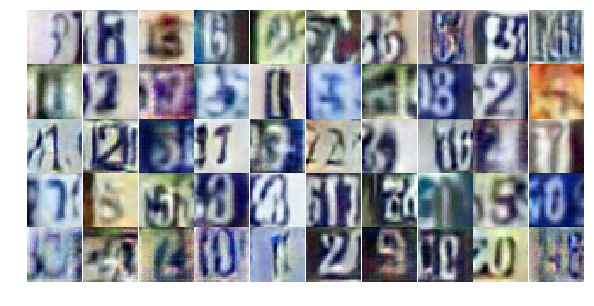

Epoch 16/25... Discriminator Loss: 1.2544... Generator Loss: 0.5164
Epoch 16/25... Discriminator Loss: 0.5594... Generator Loss: 1.2801
Epoch 16/25... Discriminator Loss: 0.6390... Generator Loss: 1.0511
Epoch 16/25... Discriminator Loss: 1.6385... Generator Loss: 0.3341
Epoch 16/25... Discriminator Loss: 4.2251... Generator Loss: 0.0479
Epoch 16/25... Discriminator Loss: 1.1385... Generator Loss: 0.9822
Epoch 16/25... Discriminator Loss: 1.6991... Generator Loss: 0.3193
Epoch 16/25... Discriminator Loss: 0.6822... Generator Loss: 1.6070
Epoch 16/25... Discriminator Loss: 0.5386... Generator Loss: 1.1605
Epoch 16/25... Discriminator Loss: 0.8189... Generator Loss: 0.8299


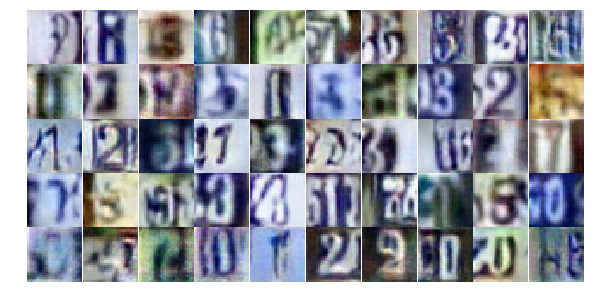

Epoch 16/25... Discriminator Loss: 0.6987... Generator Loss: 1.0711
Epoch 16/25... Discriminator Loss: 0.6717... Generator Loss: 1.2820
Epoch 16/25... Discriminator Loss: 0.9059... Generator Loss: 0.8520
Epoch 16/25... Discriminator Loss: 1.0027... Generator Loss: 0.5952
Epoch 16/25... Discriminator Loss: 0.7374... Generator Loss: 0.9940
Epoch 16/25... Discriminator Loss: 1.1108... Generator Loss: 0.5612
Epoch 16/25... Discriminator Loss: 0.7811... Generator Loss: 0.8005
Epoch 16/25... Discriminator Loss: 0.4672... Generator Loss: 1.3932
Epoch 16/25... Discriminator Loss: 1.3956... Generator Loss: 1.7691
Epoch 16/25... Discriminator Loss: 0.6560... Generator Loss: 1.1574


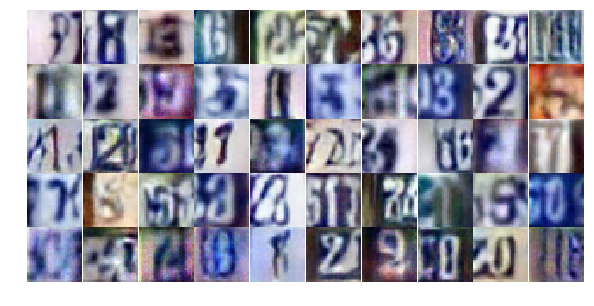

Epoch 16/25... Discriminator Loss: 0.6957... Generator Loss: 0.9029
Epoch 16/25... Discriminator Loss: 0.7069... Generator Loss: 1.0731
Epoch 16/25... Discriminator Loss: 0.5974... Generator Loss: 1.1764
Epoch 16/25... Discriminator Loss: 0.5294... Generator Loss: 1.8720
Epoch 16/25... Discriminator Loss: 0.9690... Generator Loss: 0.9802
Epoch 16/25... Discriminator Loss: 0.6942... Generator Loss: 1.1280
Epoch 16/25... Discriminator Loss: 0.8492... Generator Loss: 0.7476
Epoch 16/25... Discriminator Loss: 1.2082... Generator Loss: 0.4932
Epoch 16/25... Discriminator Loss: 0.5835... Generator Loss: 1.2361
Epoch 16/25... Discriminator Loss: 0.4296... Generator Loss: 1.8891


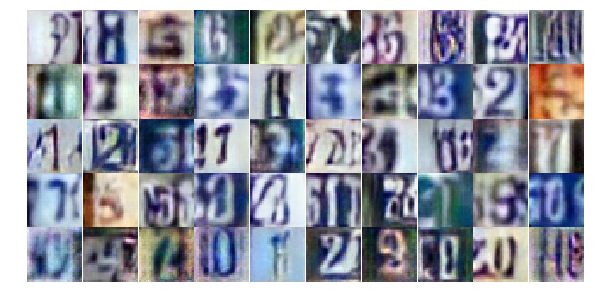

Epoch 16/25... Discriminator Loss: 0.5799... Generator Loss: 1.2426
Epoch 16/25... Discriminator Loss: 0.7011... Generator Loss: 1.0106
Epoch 16/25... Discriminator Loss: 1.3387... Generator Loss: 0.4573
Epoch 16/25... Discriminator Loss: 0.7936... Generator Loss: 0.8957
Epoch 16/25... Discriminator Loss: 0.8263... Generator Loss: 0.8115
Epoch 16/25... Discriminator Loss: 0.9965... Generator Loss: 0.7210
Epoch 16/25... Discriminator Loss: 0.4782... Generator Loss: 1.2938
Epoch 16/25... Discriminator Loss: 0.7079... Generator Loss: 0.8951
Epoch 16/25... Discriminator Loss: 0.5876... Generator Loss: 1.0859
Epoch 16/25... Discriminator Loss: 0.7412... Generator Loss: 0.9946


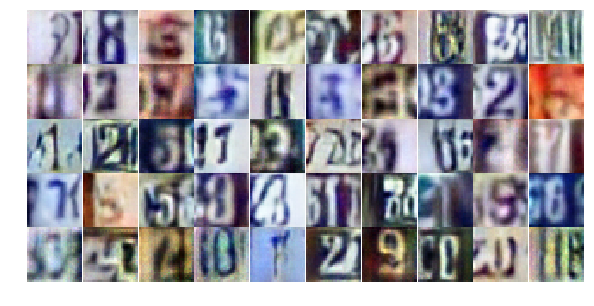

Epoch 16/25... Discriminator Loss: 1.4190... Generator Loss: 0.3975
Epoch 16/25... Discriminator Loss: 0.7526... Generator Loss: 1.4346
Epoch 16/25... Discriminator Loss: 1.9986... Generator Loss: 0.2402
Epoch 16/25... Discriminator Loss: 0.5160... Generator Loss: 2.6409
Epoch 16/25... Discriminator Loss: 0.9312... Generator Loss: 0.7522
Epoch 16/25... Discriminator Loss: 0.8439... Generator Loss: 0.8606
Epoch 17/25... Discriminator Loss: 0.8021... Generator Loss: 0.8898
Epoch 17/25... Discriminator Loss: 0.8140... Generator Loss: 0.8741
Epoch 17/25... Discriminator Loss: 0.6948... Generator Loss: 1.1415
Epoch 17/25... Discriminator Loss: 0.7488... Generator Loss: 0.9794


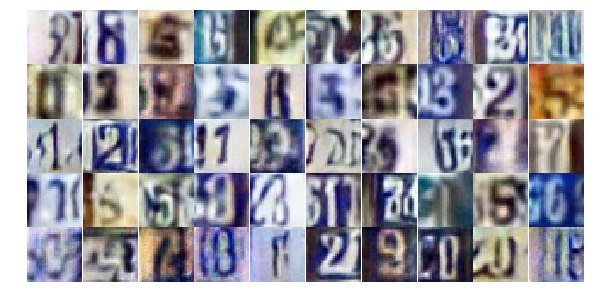

Epoch 17/25... Discriminator Loss: 0.4558... Generator Loss: 1.4734
Epoch 17/25... Discriminator Loss: 0.5909... Generator Loss: 1.0930
Epoch 17/25... Discriminator Loss: 0.7682... Generator Loss: 0.9353
Epoch 17/25... Discriminator Loss: 0.7979... Generator Loss: 0.8571
Epoch 17/25... Discriminator Loss: 0.7725... Generator Loss: 0.8892
Epoch 17/25... Discriminator Loss: 0.8298... Generator Loss: 0.8409
Epoch 17/25... Discriminator Loss: 0.6799... Generator Loss: 1.3316
Epoch 17/25... Discriminator Loss: 0.9716... Generator Loss: 0.6721
Epoch 17/25... Discriminator Loss: 0.4103... Generator Loss: 2.0166
Epoch 17/25... Discriminator Loss: 0.6248... Generator Loss: 1.3133


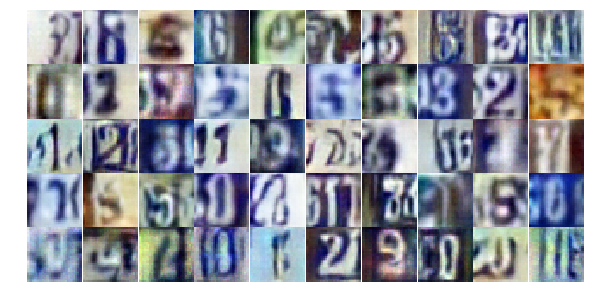

Epoch 17/25... Discriminator Loss: 0.8517... Generator Loss: 0.8246
Epoch 17/25... Discriminator Loss: 0.8638... Generator Loss: 0.7474
Epoch 17/25... Discriminator Loss: 0.6700... Generator Loss: 0.9385
Epoch 17/25... Discriminator Loss: 0.6864... Generator Loss: 1.2617
Epoch 17/25... Discriminator Loss: 2.2984... Generator Loss: 0.2245
Epoch 17/25... Discriminator Loss: 0.9885... Generator Loss: 0.6820
Epoch 17/25... Discriminator Loss: 0.6115... Generator Loss: 1.5404
Epoch 17/25... Discriminator Loss: 0.8336... Generator Loss: 0.8941
Epoch 17/25... Discriminator Loss: 0.7932... Generator Loss: 0.8142
Epoch 17/25... Discriminator Loss: 0.4623... Generator Loss: 1.5843


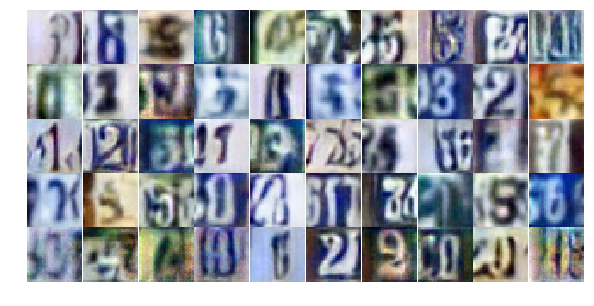

Epoch 17/25... Discriminator Loss: 1.7585... Generator Loss: 0.2808
Epoch 17/25... Discriminator Loss: 0.5898... Generator Loss: 1.2507
Epoch 17/25... Discriminator Loss: 0.6923... Generator Loss: 0.9550
Epoch 17/25... Discriminator Loss: 0.9523... Generator Loss: 0.8479
Epoch 17/25... Discriminator Loss: 1.0818... Generator Loss: 0.5946
Epoch 17/25... Discriminator Loss: 0.6186... Generator Loss: 1.1544
Epoch 17/25... Discriminator Loss: 0.6016... Generator Loss: 1.1577
Epoch 17/25... Discriminator Loss: 0.6849... Generator Loss: 1.0183
Epoch 17/25... Discriminator Loss: 1.1961... Generator Loss: 0.5439
Epoch 17/25... Discriminator Loss: 0.3834... Generator Loss: 1.5755


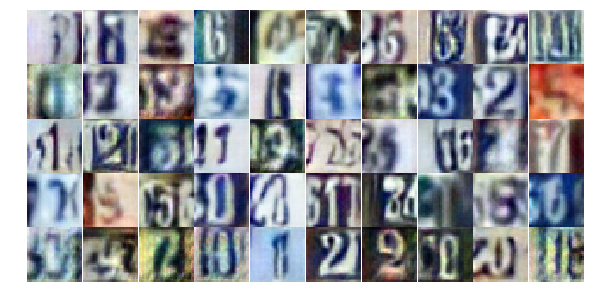

Epoch 17/25... Discriminator Loss: 0.5826... Generator Loss: 1.4685
Epoch 17/25... Discriminator Loss: 1.3043... Generator Loss: 0.5028
Epoch 17/25... Discriminator Loss: 0.5484... Generator Loss: 1.3733
Epoch 17/25... Discriminator Loss: 0.6454... Generator Loss: 1.1316
Epoch 17/25... Discriminator Loss: 0.8229... Generator Loss: 0.8094
Epoch 17/25... Discriminator Loss: 0.5896... Generator Loss: 1.3318
Epoch 17/25... Discriminator Loss: 0.7524... Generator Loss: 1.0269
Epoch 17/25... Discriminator Loss: 0.4705... Generator Loss: 1.5170
Epoch 17/25... Discriminator Loss: 0.3200... Generator Loss: 2.0044
Epoch 17/25... Discriminator Loss: 1.2844... Generator Loss: 0.4588


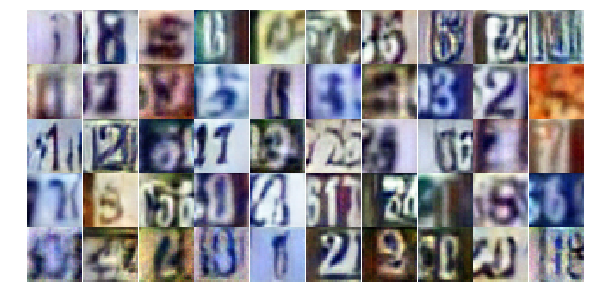

Epoch 17/25... Discriminator Loss: 1.8679... Generator Loss: 1.9491
Epoch 17/25... Discriminator Loss: 0.2935... Generator Loss: 2.4719
Epoch 17/25... Discriminator Loss: 0.7811... Generator Loss: 1.1674
Epoch 17/25... Discriminator Loss: 0.4064... Generator Loss: 1.6151
Epoch 17/25... Discriminator Loss: 0.7293... Generator Loss: 0.8950
Epoch 17/25... Discriminator Loss: 0.7600... Generator Loss: 0.9421
Epoch 17/25... Discriminator Loss: 1.0851... Generator Loss: 0.5507
Epoch 17/25... Discriminator Loss: 0.7159... Generator Loss: 0.9884
Epoch 17/25... Discriminator Loss: 1.0823... Generator Loss: 2.4738
Epoch 17/25... Discriminator Loss: 1.5826... Generator Loss: 0.4127


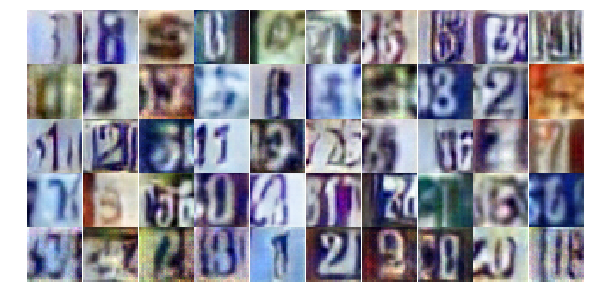

Epoch 17/25... Discriminator Loss: 0.8829... Generator Loss: 1.2921
Epoch 17/25... Discriminator Loss: 1.0190... Generator Loss: 0.7006
Epoch 17/25... Discriminator Loss: 0.6598... Generator Loss: 1.0277
Epoch 17/25... Discriminator Loss: 0.7324... Generator Loss: 2.6806
Epoch 18/25... Discriminator Loss: 1.1099... Generator Loss: 0.6309
Epoch 18/25... Discriminator Loss: 0.8886... Generator Loss: 0.7254
Epoch 18/25... Discriminator Loss: 0.7762... Generator Loss: 0.9123
Epoch 18/25... Discriminator Loss: 0.9159... Generator Loss: 0.6894
Epoch 18/25... Discriminator Loss: 1.0540... Generator Loss: 0.5882
Epoch 18/25... Discriminator Loss: 0.7279... Generator Loss: 0.9416


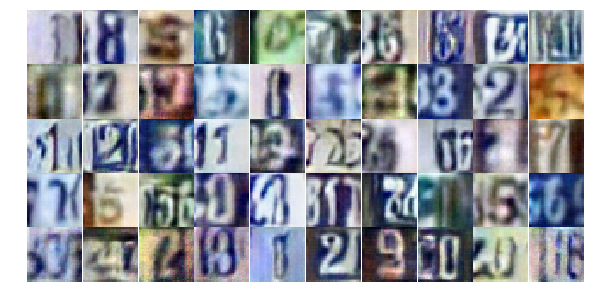

Epoch 18/25... Discriminator Loss: 0.3746... Generator Loss: 1.5635
Epoch 18/25... Discriminator Loss: 1.1442... Generator Loss: 0.6343
Epoch 18/25... Discriminator Loss: 1.0269... Generator Loss: 0.5976
Epoch 18/25... Discriminator Loss: 0.4173... Generator Loss: 1.5798
Epoch 18/25... Discriminator Loss: 0.6456... Generator Loss: 2.7518
Epoch 18/25... Discriminator Loss: 0.9052... Generator Loss: 0.9786
Epoch 18/25... Discriminator Loss: 0.5107... Generator Loss: 1.2411
Epoch 18/25... Discriminator Loss: 0.7635... Generator Loss: 0.8626
Epoch 18/25... Discriminator Loss: 0.8216... Generator Loss: 2.6102
Epoch 18/25... Discriminator Loss: 0.4335... Generator Loss: 1.8173


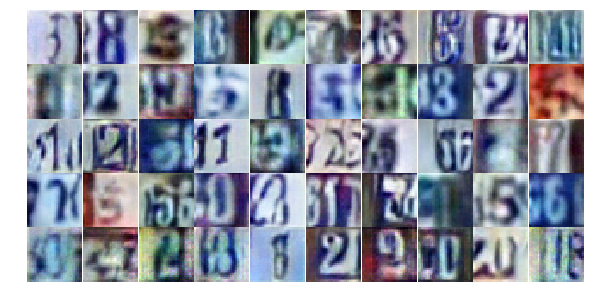

Epoch 18/25... Discriminator Loss: 0.6321... Generator Loss: 1.4574
Epoch 18/25... Discriminator Loss: 0.5449... Generator Loss: 1.4918
Epoch 18/25... Discriminator Loss: 1.3099... Generator Loss: 0.4481
Epoch 18/25... Discriminator Loss: 0.4189... Generator Loss: 1.5926
Epoch 18/25... Discriminator Loss: 0.9461... Generator Loss: 0.7234
Epoch 18/25... Discriminator Loss: 0.9531... Generator Loss: 0.6969
Epoch 18/25... Discriminator Loss: 0.7039... Generator Loss: 1.6187
Epoch 18/25... Discriminator Loss: 1.1592... Generator Loss: 0.5930
Epoch 18/25... Discriminator Loss: 0.5420... Generator Loss: 1.3918
Epoch 18/25... Discriminator Loss: 0.5733... Generator Loss: 1.2750


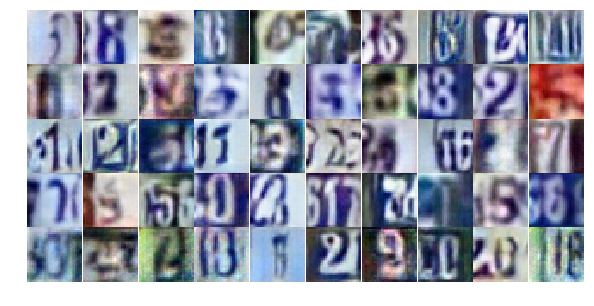

Epoch 18/25... Discriminator Loss: 0.5102... Generator Loss: 1.4184
Epoch 18/25... Discriminator Loss: 0.6500... Generator Loss: 1.3393
Epoch 18/25... Discriminator Loss: 0.6272... Generator Loss: 0.9965
Epoch 18/25... Discriminator Loss: 0.7276... Generator Loss: 0.9389
Epoch 18/25... Discriminator Loss: 1.0851... Generator Loss: 0.5438
Epoch 18/25... Discriminator Loss: 0.7107... Generator Loss: 1.1630
Epoch 18/25... Discriminator Loss: 0.6705... Generator Loss: 1.1849
Epoch 18/25... Discriminator Loss: 0.6235... Generator Loss: 1.1696
Epoch 18/25... Discriminator Loss: 0.6860... Generator Loss: 0.9380
Epoch 18/25... Discriminator Loss: 0.5901... Generator Loss: 1.2092


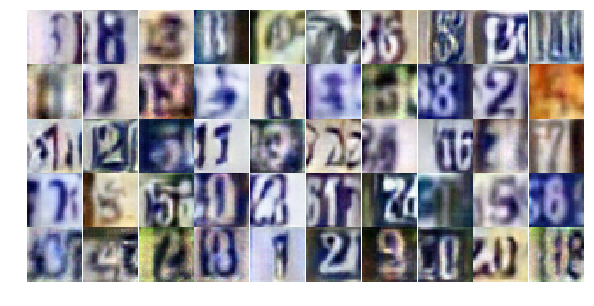

Epoch 18/25... Discriminator Loss: 0.6980... Generator Loss: 1.1558
Epoch 18/25... Discriminator Loss: 0.5484... Generator Loss: 1.3296
Epoch 18/25... Discriminator Loss: 0.6606... Generator Loss: 1.0247
Epoch 18/25... Discriminator Loss: 0.4057... Generator Loss: 1.8773
Epoch 18/25... Discriminator Loss: 0.7919... Generator Loss: 0.9537
Epoch 18/25... Discriminator Loss: 0.3787... Generator Loss: 1.6320
Epoch 18/25... Discriminator Loss: 0.7646... Generator Loss: 0.8721
Epoch 18/25... Discriminator Loss: 1.5218... Generator Loss: 3.0762
Epoch 18/25... Discriminator Loss: 1.3473... Generator Loss: 0.5144
Epoch 18/25... Discriminator Loss: 0.3742... Generator Loss: 1.7505


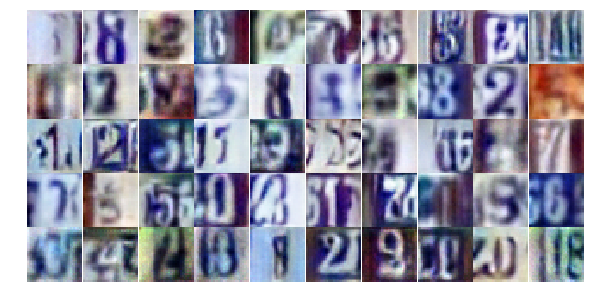

Epoch 18/25... Discriminator Loss: 0.5543... Generator Loss: 1.2475
Epoch 18/25... Discriminator Loss: 0.7648... Generator Loss: 0.9861
Epoch 18/25... Discriminator Loss: 0.6313... Generator Loss: 1.3489
Epoch 18/25... Discriminator Loss: 0.8922... Generator Loss: 0.7235
Epoch 18/25... Discriminator Loss: 0.8462... Generator Loss: 0.8066
Epoch 18/25... Discriminator Loss: 0.5685... Generator Loss: 1.8523
Epoch 18/25... Discriminator Loss: 0.5737... Generator Loss: 1.2661
Epoch 18/25... Discriminator Loss: 0.3432... Generator Loss: 1.9397
Epoch 18/25... Discriminator Loss: 1.2255... Generator Loss: 0.4917
Epoch 18/25... Discriminator Loss: 0.8613... Generator Loss: 0.8013


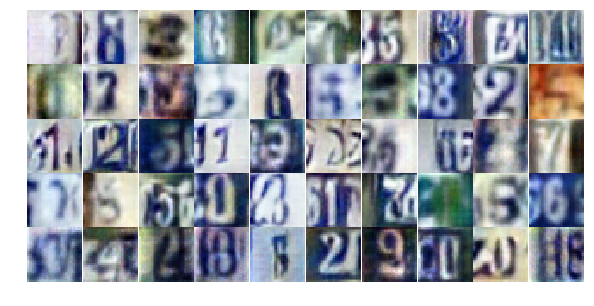

Epoch 18/25... Discriminator Loss: 0.4506... Generator Loss: 1.6821
Epoch 19/25... Discriminator Loss: 0.6943... Generator Loss: 1.2624
Epoch 19/25... Discriminator Loss: 1.1500... Generator Loss: 0.5610
Epoch 19/25... Discriminator Loss: 0.7336... Generator Loss: 1.8993
Epoch 19/25... Discriminator Loss: 0.4796... Generator Loss: 1.5690
Epoch 19/25... Discriminator Loss: 0.9181... Generator Loss: 0.7736
Epoch 19/25... Discriminator Loss: 0.4891... Generator Loss: 1.4974
Epoch 19/25... Discriminator Loss: 1.0893... Generator Loss: 0.6421
Epoch 19/25... Discriminator Loss: 0.6667... Generator Loss: 2.9771
Epoch 19/25... Discriminator Loss: 1.0844... Generator Loss: 0.5734


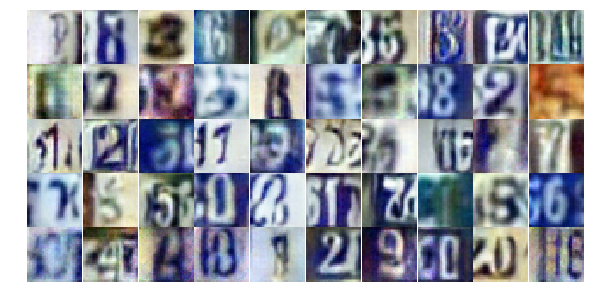

Epoch 19/25... Discriminator Loss: 0.6361... Generator Loss: 0.9781
Epoch 19/25... Discriminator Loss: 0.9767... Generator Loss: 0.7352
Epoch 19/25... Discriminator Loss: 0.5494... Generator Loss: 1.3718
Epoch 19/25... Discriminator Loss: 0.8927... Generator Loss: 0.7883
Epoch 19/25... Discriminator Loss: 0.8348... Generator Loss: 0.9052
Epoch 19/25... Discriminator Loss: 0.5783... Generator Loss: 1.5110
Epoch 19/25... Discriminator Loss: 1.1276... Generator Loss: 2.5586
Epoch 19/25... Discriminator Loss: 0.6548... Generator Loss: 1.3098
Epoch 19/25... Discriminator Loss: 0.7696... Generator Loss: 0.8954
Epoch 19/25... Discriminator Loss: 1.1715... Generator Loss: 0.5305


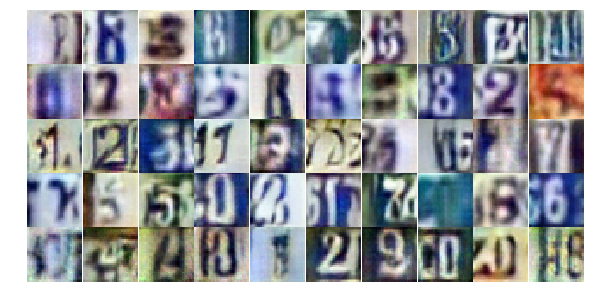

Epoch 19/25... Discriminator Loss: 0.8552... Generator Loss: 0.8188
Epoch 19/25... Discriminator Loss: 1.5697... Generator Loss: 0.3668
Epoch 19/25... Discriminator Loss: 1.5093... Generator Loss: 0.4771
Epoch 19/25... Discriminator Loss: 0.8769... Generator Loss: 0.9173
Epoch 19/25... Discriminator Loss: 1.4381... Generator Loss: 0.4366
Epoch 19/25... Discriminator Loss: 0.7814... Generator Loss: 1.0111
Epoch 19/25... Discriminator Loss: 0.7778... Generator Loss: 0.9003
Epoch 19/25... Discriminator Loss: 0.5740... Generator Loss: 1.0875
Epoch 19/25... Discriminator Loss: 0.7192... Generator Loss: 0.9348
Epoch 19/25... Discriminator Loss: 0.9568... Generator Loss: 1.0482


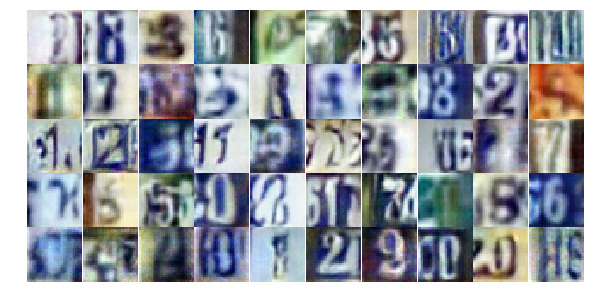

Epoch 19/25... Discriminator Loss: 1.2832... Generator Loss: 0.4894
Epoch 19/25... Discriminator Loss: 0.6270... Generator Loss: 1.0767
Epoch 19/25... Discriminator Loss: 0.8714... Generator Loss: 0.7415
Epoch 19/25... Discriminator Loss: 0.5929... Generator Loss: 1.1642
Epoch 19/25... Discriminator Loss: 0.6588... Generator Loss: 1.1112
Epoch 19/25... Discriminator Loss: 1.1378... Generator Loss: 0.5260
Epoch 19/25... Discriminator Loss: 0.6857... Generator Loss: 1.1750
Epoch 19/25... Discriminator Loss: 0.4823... Generator Loss: 1.5975
Epoch 19/25... Discriminator Loss: 0.5621... Generator Loss: 1.4155
Epoch 19/25... Discriminator Loss: 0.6001... Generator Loss: 1.0930


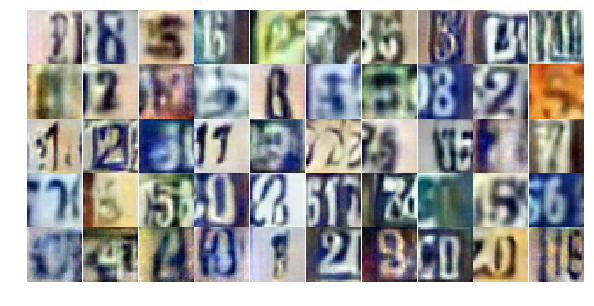

Epoch 19/25... Discriminator Loss: 0.6638... Generator Loss: 0.9414
Epoch 19/25... Discriminator Loss: 0.8659... Generator Loss: 0.7095
Epoch 19/25... Discriminator Loss: 1.2833... Generator Loss: 0.4683
Epoch 19/25... Discriminator Loss: 2.6885... Generator Loss: 5.1426
Epoch 19/25... Discriminator Loss: 1.4004... Generator Loss: 1.7333
Epoch 19/25... Discriminator Loss: 0.7533... Generator Loss: 1.3023
Epoch 19/25... Discriminator Loss: 0.8771... Generator Loss: 2.0755
Epoch 19/25... Discriminator Loss: 0.5073... Generator Loss: 1.5245
Epoch 19/25... Discriminator Loss: 0.7132... Generator Loss: 1.1727
Epoch 19/25... Discriminator Loss: 1.0650... Generator Loss: 0.6331


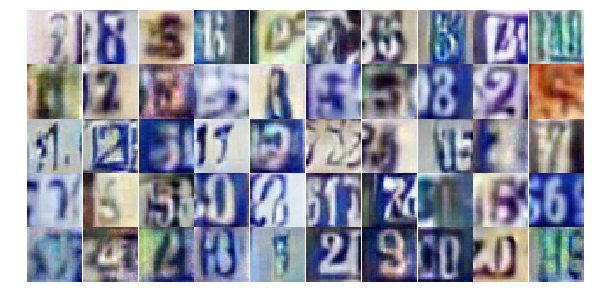

Epoch 19/25... Discriminator Loss: 0.7781... Generator Loss: 0.8752
Epoch 19/25... Discriminator Loss: 0.7812... Generator Loss: 0.9392
Epoch 19/25... Discriminator Loss: 0.6021... Generator Loss: 1.5850
Epoch 19/25... Discriminator Loss: 1.0137... Generator Loss: 0.6913
Epoch 19/25... Discriminator Loss: 0.6735... Generator Loss: 1.6218
Epoch 19/25... Discriminator Loss: 0.6719... Generator Loss: 1.2897
Epoch 19/25... Discriminator Loss: 1.4561... Generator Loss: 0.4261
Epoch 19/25... Discriminator Loss: 0.6102... Generator Loss: 1.2590
Epoch 20/25... Discriminator Loss: 0.6671... Generator Loss: 1.3559
Epoch 20/25... Discriminator Loss: 0.7434... Generator Loss: 0.9886


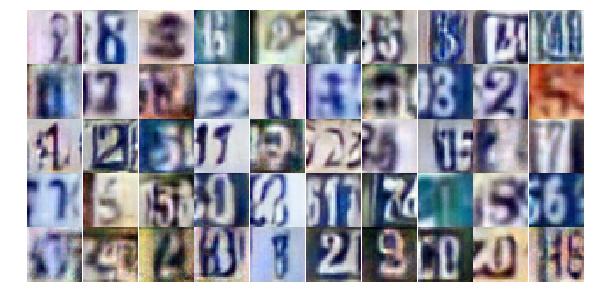

Epoch 20/25... Discriminator Loss: 0.6769... Generator Loss: 1.0323
Epoch 20/25... Discriminator Loss: 0.9766... Generator Loss: 0.7886
Epoch 20/25... Discriminator Loss: 1.3999... Generator Loss: 0.3749
Epoch 20/25... Discriminator Loss: 1.3557... Generator Loss: 0.4280
Epoch 20/25... Discriminator Loss: 0.6192... Generator Loss: 1.1236
Epoch 20/25... Discriminator Loss: 0.5935... Generator Loss: 1.1687
Epoch 20/25... Discriminator Loss: 0.6088... Generator Loss: 1.0963
Epoch 20/25... Discriminator Loss: 0.9975... Generator Loss: 0.7113
Epoch 20/25... Discriminator Loss: 0.8695... Generator Loss: 0.8220
Epoch 20/25... Discriminator Loss: 0.6957... Generator Loss: 1.0006


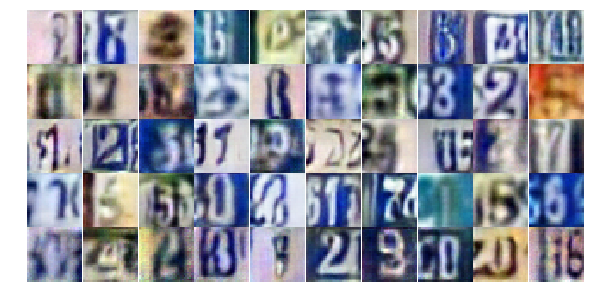

Epoch 20/25... Discriminator Loss: 1.1210... Generator Loss: 0.6938
Epoch 20/25... Discriminator Loss: 0.8822... Generator Loss: 0.8168
Epoch 20/25... Discriminator Loss: 0.9433... Generator Loss: 0.6849
Epoch 20/25... Discriminator Loss: 0.8423... Generator Loss: 0.7680
Epoch 20/25... Discriminator Loss: 1.1349... Generator Loss: 0.5590
Epoch 20/25... Discriminator Loss: 1.1688... Generator Loss: 0.4980
Epoch 20/25... Discriminator Loss: 1.6679... Generator Loss: 0.3139
Epoch 20/25... Discriminator Loss: 0.6824... Generator Loss: 0.9680
Epoch 20/25... Discriminator Loss: 0.5179... Generator Loss: 1.2998
Epoch 20/25... Discriminator Loss: 0.9535... Generator Loss: 0.7423


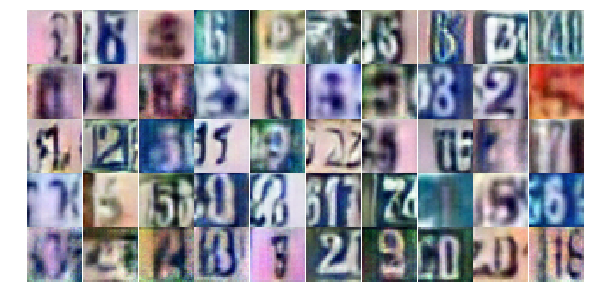

Epoch 20/25... Discriminator Loss: 0.6921... Generator Loss: 0.9434


KeyboardInterrupt: 

In [38]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

NameError: name 'losses' is not defined

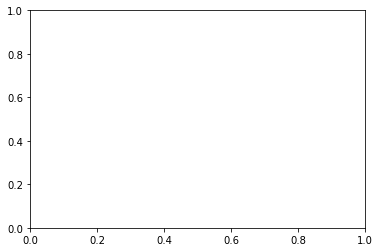

In [39]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 5, 10, figsize=(10,5))